<a href="https://colab.research.google.com/github/Iliasecc/Projet_innovation/blob/main/Entrainement_modele.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Entrainement du modele

In [ ]:
# Install Ultralytics library
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 898.7/898.7 kB 25.7 MB/s eta 0:00:00


In [ ]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')

100%|██████████| 6.25M/6.25M [00:00<00:00, 102MB/s]



image 1/1 /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 9 cars, 84.1ms
Speed: 12.1ms preprocess, 84.1ms inference, 687.7ms postprocess per image at shape (1, 3, 384, 640)


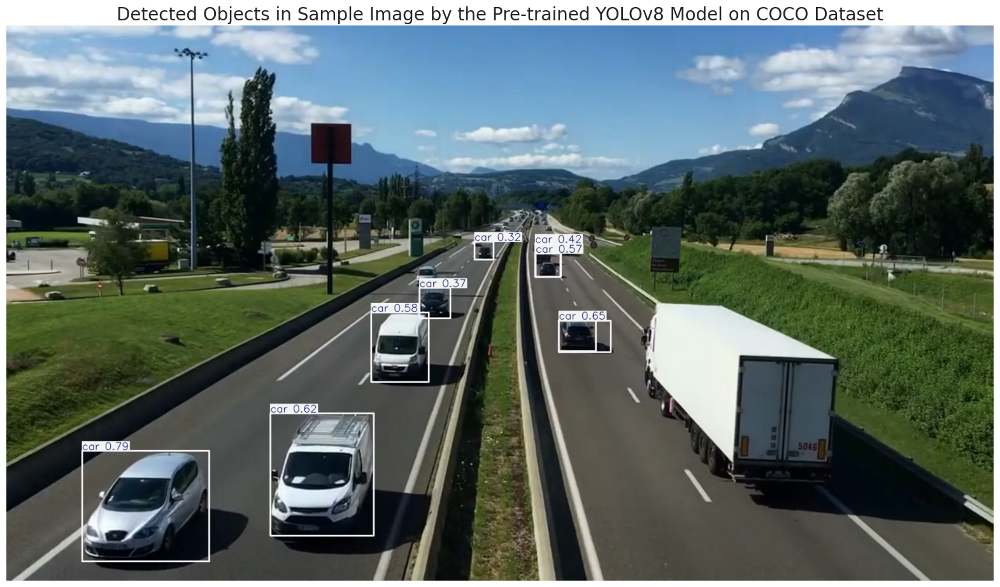

In [ ]:
# Path to the image file
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')
image_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.3)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images1/pic1 (1) (1).jpg: 256x640 5 persons, 2 cars, 1 bus, 49.6ms
Speed: 1.3ms preprocess, 49.6ms inference, 1.4ms postprocess per image at shape (1, 3, 256, 640)


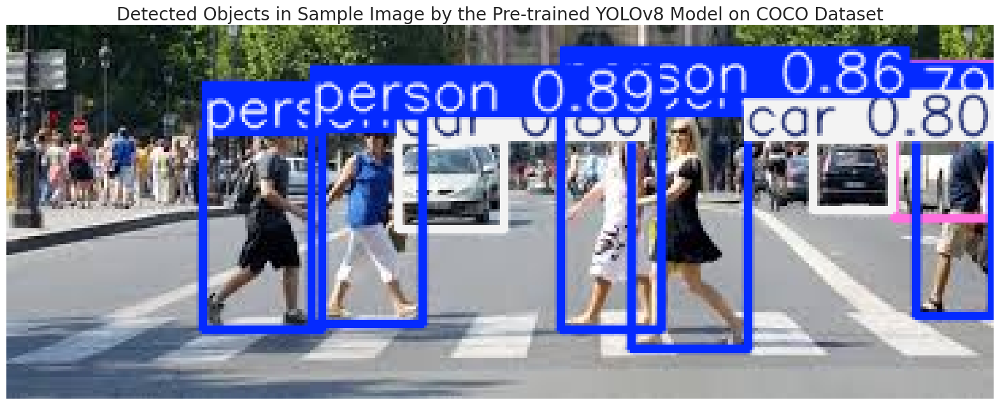

In [ ]:
# Path to the image file
image_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images1/pic1 (1) (1).jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images1/val (25).jpg: 416x640 2 persons, 3 cars, 275.4ms
Speed: 3.2ms preprocess, 275.4ms inference, 1.6ms postprocess per image at shape (1, 3, 416, 640)


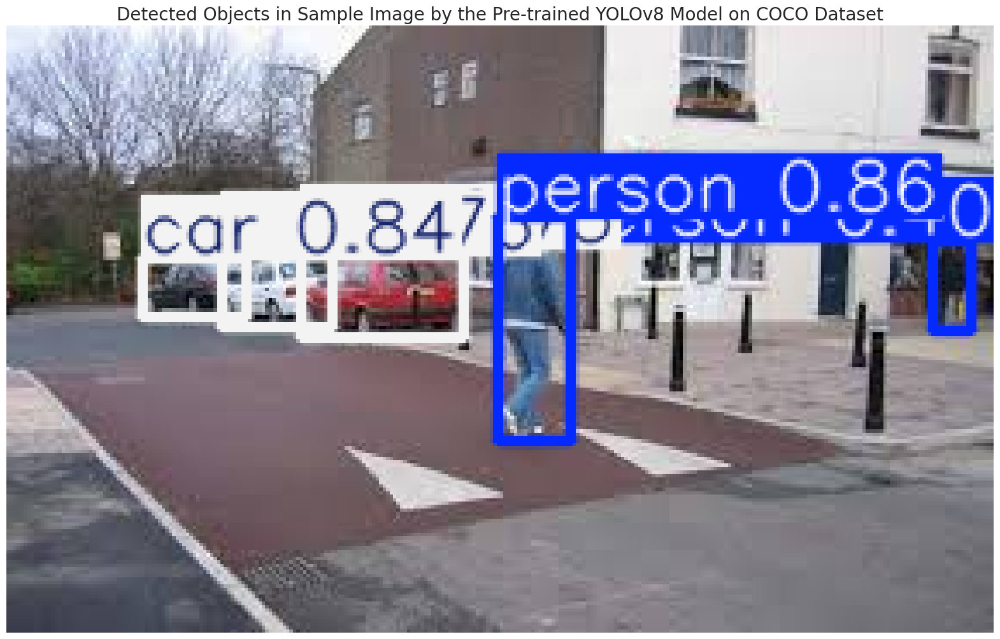

In [ ]:
# Path to the image file
image_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images1/val (25).jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.3)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [ ]:
import cv2
from ultralytics import YOLO

# Charger le modèle YOLO pré-entraîné
model = YOLO('yolov8n.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/fourway.avi'

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Définir le chemin et les paramètres de la vidéo de sortie
output_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/output1_video.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Effectuer la prédiction sur la frame actuelle
    results = model.predict(source=frame, imgsz=640, conf=0.3, verbose=False)

    # Annoter la frame avec les résultats de la détection
    annotated_frame = results[0].plot(line_width=2)

    # Écrire la frame annotée dans la vidéo de sortie
    out.write(annotated_frame)

# Libérer les ressources
cap.release()
out.release()

# Remarque : Pas besoin de cv2.destroyAllWindows() ici, car aucune fenêtre n'est créée.

print(f"La vidéo annotée a été sauvegardée à: {output_path}")


La vidéo annotée a été sauvegardée à: /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/output1_video.avi


In [ ]:
# Define the dataset_path
dataset_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))

names:
- Vehicle
- Pedestrian
nc: 2
roboflow:
  license: CC BY 4.0
  project: vehicle_detection_yolov8
  url: https://universe.roboflow.com/farzad/vehicle_detection_yolov8/dataset/3
  version: 3
  workspace: farzad
train: ../train/combined1_images
val: ../valid/combined1_images



In [ ]:
import os
from PIL import Image

# Paths for training and validation datasets
train_vehicle_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images"
train_pedestrian_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images1"
valid_vehicle_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images"
valid_pedestrian_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images1"

# Initialize counters and sets for sizes
num_train_images = 0
num_valid_images = 0
train_image_sizes = set()
valid_image_sizes = set()

# Function to process images in a given directory
def process_images(image_dir, image_count, size_set):
    for filename in os.listdir(image_dir):
        if filename.endswith('.jpg'):
            image_count += 1
            image_path = os.path.join(image_dir, filename)
            with Image.open(image_path) as img:
                size_set.add(img.size)
    return image_count

# Process training images
num_train_images = process_images(train_vehicle_images_path, num_train_images, train_image_sizes)
num_train_images = process_images(train_pedestrian_images_path, num_train_images, train_image_sizes)

# Process validation images
num_valid_images = process_images(valid_vehicle_images_path, num_valid_images, valid_image_sizes)
num_valid_images = process_images(valid_pedestrian_images_path, num_valid_images, valid_image_sizes)

# Print results
print(f"Total training images: {num_train_images}")
print(f"Total validation images: {num_valid_images}")

# Check uniformity of image sizes
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes.")


Total training images: 1354
Total validation images: 267
Training images have varying sizes.
Validation images have varying sizes.


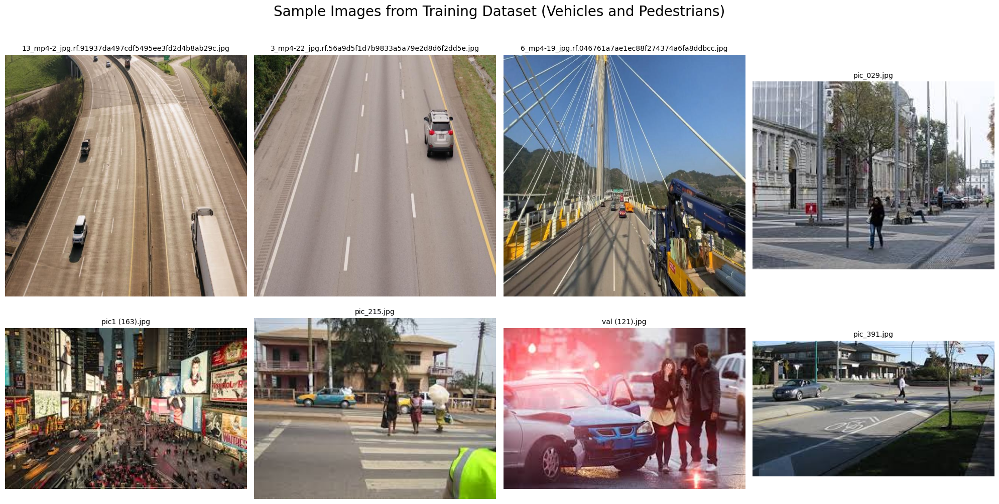

In [ ]:
import os
from PIL import Image
import matplotlib.pyplot as plt

# Paths for training images
vehicle_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images"
pedestrian_images_path = "/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images1"

# Combine all jpg images from both directories
vehicle_image_files = [os.path.join(vehicle_images_path, file) for file in os.listdir(vehicle_images_path) if file.endswith('.jpg')]
pedestrian_image_files = [os.path.join(pedestrian_images_path, file) for file in os.listdir(pedestrian_images_path) if file.endswith('.jpg')]

# Merge lists and randomly select 8 images
all_image_files = vehicle_image_files + pedestrian_image_files
num_images = len(all_image_files)

if num_images < 8:
    raise ValueError("Not enough images to select 8 samples.")

selected_images = [all_image_files[i] for i in range(100, num_images, max(1, num_images // 8))][:8]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_path in zip(axes.ravel(), selected_images):
    # Open the image file
    image = Image.open(img_path)
    # Display the image on the subplot
    ax.imshow(image)
    # Turn off axis labels for cleaner presentation
    ax.axis('off')
    # Add image name as title for clarity
    ax.set_title(os.path.basename(img_path), fontsize=10)

# Add a title to the entire figure
plt.suptitle('Sample Images from Training Dataset (Vehicles and Pedestrians)', fontsize=20)
# Adjust the layout to prevent overlapping subplots
plt.tight_layout(rect=[0, 0, 1, 0.96])  # Adjust layout to avoid title overlap
# Display the figure with all the subplots
plt.show()


Fine-Tuning YOLOv8

In [ ]:
import os
import shutil

def combine_directories(src_dirs, dest_dir):
    """
    Combine plusieurs répertoires en un seul.
    """
    if not os.path.exists(dest_dir):
        os.makedirs(dest_dir)

    for src_dir in src_dirs:
        for file_name in os.listdir(src_dir):
            src_file = os.path.join(src_dir, file_name)
            dest_file = os.path.join(dest_dir, file_name)
            if os.path.isfile(src_file):
                shutil.copy(src_file, dest_file)

def get_image_details(directory):
    """
    Compter le nombre d'images et vérifier les tailles dans un répertoire.
    """
    image_count = 0
    image_sizes = set()  # Utilisation d'un set pour vérifier si les tailles varient
    for dirpath, dirnames, filenames in os.walk(directory):
        for filename in filenames:
            if filename.endswith(('.png', '.jpg', '.jpeg', '.bmp', '.tiff')):  # Formats d'image supportés
                image_count += 1
                with Image.open(os.path.join(dirpath, filename)) as img:
                    image_sizes.add(img.size)  # Ajouter la taille de l'image (largeur, hauteur)
    return image_count, image_sizes

# Spécification des chemins des répertoires à combiner
train_images_dirs = [
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images',
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/images1'
]
train_labels_dirs = [
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/labels',
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/labels1'
]
valid_images_dirs = [
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images',
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/images1'
]
valid_labels_dirs = [
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/labels',
    '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/labels1'
]

# Spécification des répertoires combinés
combined_train_images = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/combined1_images'
combined_train_labels = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/combined1_labels'
combined_valid_images = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/combined1_images'
combined_valid_labels = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/combined1_labels'

# Combinaison des répertoires d'images et de labels
combine_directories(train_images_dirs, combined_train_images)
combine_directories(train_labels_dirs, combined_train_labels)
combine_directories(valid_images_dirs, combined_valid_images)
combine_directories(valid_labels_dirs, combined_valid_labels)

# Calcul du nombre d'images dans les répertoires combinés
from PIL import Image

# Calcul du nombre d'images et de la taille dans les répertoires combinés
train_image_count, train_image_sizes = get_image_details(combined_train_images)
valid_image_count, valid_image_sizes = get_image_details(combined_valid_images)

# Affichage des résultats
print(f"Total training images: {train_image_count}")
print(f"Total validation images: {valid_image_count}")

# Vérification si les tailles des images varient
if len(train_image_sizes) > 1:
    print("Training images have varying sizes.")
else:
    print("Training images have the same size.")

if len(valid_image_sizes) > 1:
    print("Validation images have varying sizes.")
else:
    print("Validation images have the same size.")


Total training images: 1354
Total validation images: 267
Training images have varying sizes.
Validation images have varying sizes.


In [ ]:
# Définir le chemin vers le fichier YAML mis à jour
yaml_file_path = os.path.join(dataset_path, 'data.yaml')
Result_Final_model = model.train(
    data=yaml_file_path,   # Chemin vers le fichier YAML de configuration des données
    epochs=60,             # Nombre d'époques pour l'entraînement
    imgsz=480,             # Taille des images d'entrée (hauteur/largeur)
    patience=1000000,      # Augmenter la patience pour désactiver l'arrêt précoce
    batch=16,              # Taille de lot (batch size)
    lr0=0.001,             # Taux d'apprentissage initial
    lrf=0.1,               # Taux d'apprentissage final (multiplié à lr0)
    dropout=0.1            # Taux de dropout pour la régularisation
)


# Ajouter un commentaire pour rappeler la clé API
# api key: d67d39ee74b3da2e0d06a12fb2cc594b9a6c82b7



Ultralytics 8.3.38 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/data.yaml, epochs=60, time=None, patience=1000000, batch=16, imgsz=480, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train5, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_cro

train: Scanning /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/train/labels.cache... 536 images, 0 backgrounds, 0 corrupt: 100%|██████████| 536/536 [00:00<?, ?it/s]

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))



val: Scanning /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]


Plotting labels to runs/detect/train5/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 480 train, 480 val
Using 2 dataloader workers
Logging results to runs/detect/train5
Starting training for 60 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/60      1.77G      4.142      7.382      3.029        168        480: 100%|██████████| 34/34 [00:24<00:00,  1.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.81it/s]

                   all         90        937          0          0          0          0



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/60      1.69G      3.078      4.117      2.152        157        480: 100%|██████████| 34/34 [00:08<00:00,  3.93it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.26it/s]

                   all         90        937     0.0711      0.366       0.06     0.0232



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/60      1.64G      2.223      1.966      1.579         79        480: 100%|██████████| 34/34 [00:12<00:00,  2.71it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.38it/s]

                   all         90        937      0.489      0.466      0.456      0.218



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/60      1.79G      1.814      1.399      1.334         86        480: 100%|██████████| 34/34 [00:12<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.50it/s]

                   all         90        937      0.695      0.624      0.694      0.381



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/60      1.58G      1.567      1.199      1.216         65        480: 100%|██████████| 34/34 [00:12<00:00,  2.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.68it/s]

                   all         90        937       0.75      0.708      0.796      0.486



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/60      1.69G      1.474      1.098      1.153         88        480: 100%|██████████| 34/34 [00:13<00:00,  2.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.94it/s]

                   all         90        937      0.828      0.772      0.868      0.544



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/60      1.57G      1.377     0.9686      1.112         76        480: 100%|██████████| 34/34 [00:10<00:00,  3.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.17it/s]

                   all         90        937      0.811      0.774      0.869      0.561



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/60      1.68G      1.344     0.9294       1.09        109        480: 100%|██████████| 34/34 [00:10<00:00,  3.18it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:00<00:00,  3.26it/s]

                   all         90        937      0.831      0.804      0.887      0.583



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/60      1.55G      1.275     0.8587      1.068        111        480: 100%|██████████| 34/34 [00:13<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.25it/s]

                   all         90        937      0.832      0.845      0.906      0.601



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/60      1.61G      1.265     0.8155       1.06        103        480: 100%|██████████| 34/34 [00:08<00:00,  4.06it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.69it/s]

                   all         90        937      0.866      0.843       0.92      0.612



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/60      1.68G      1.224     0.7888      1.042        122        480: 100%|██████████| 34/34 [00:15<00:00,  2.25it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.63it/s]

                   all         90        937      0.839       0.86      0.922       0.62



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/60      1.62G      1.219     0.7706      1.042        149        480: 100%|██████████| 34/34 [00:10<00:00,  3.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.00s/it]

                   all         90        937      0.872      0.849      0.929      0.625



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/60      1.63G      1.194     0.7465      1.031        103        480: 100%|██████████| 34/34 [00:09<00:00,  3.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.99it/s]

                   all         90        937      0.854      0.886      0.937      0.631



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/60       1.5G      1.201     0.7548      1.027         53        480: 100%|██████████| 34/34 [00:14<00:00,  2.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.74it/s]

                   all         90        937      0.892      0.858      0.944      0.645



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/60      1.65G      1.174     0.7305      1.008        246        480:  82%|████████▏ | 28/34 [00:07<00:01,  3.48it/s]

performance

In [ ]:
# Define the path to the directory
post_training_files_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/runs/detect/train'

# List the files in the directory
!ls {post_training_files_path}

ls: cannot access '/content/drive/MyDrive/inno': No such file or directory
ls: cannot access 'data/Vehicle_Detection_Image_Dataset/runs/detect/train': No such file or directory


In [ ]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

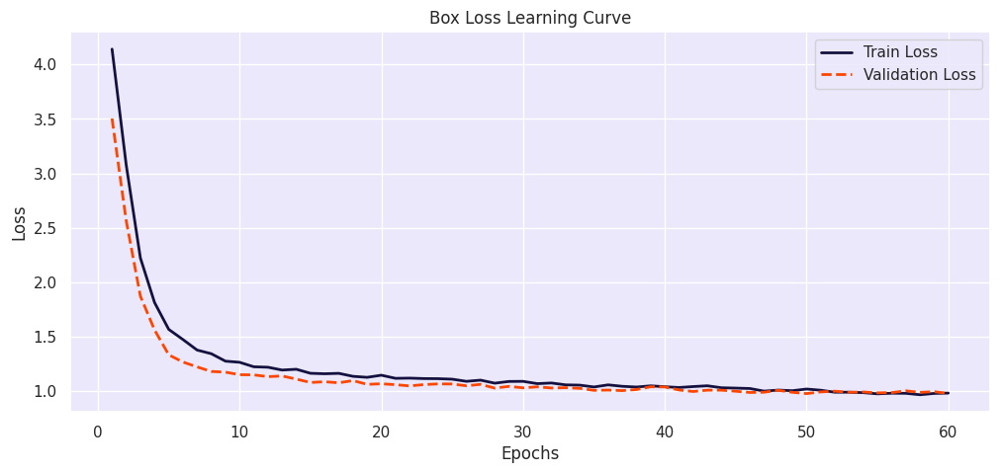

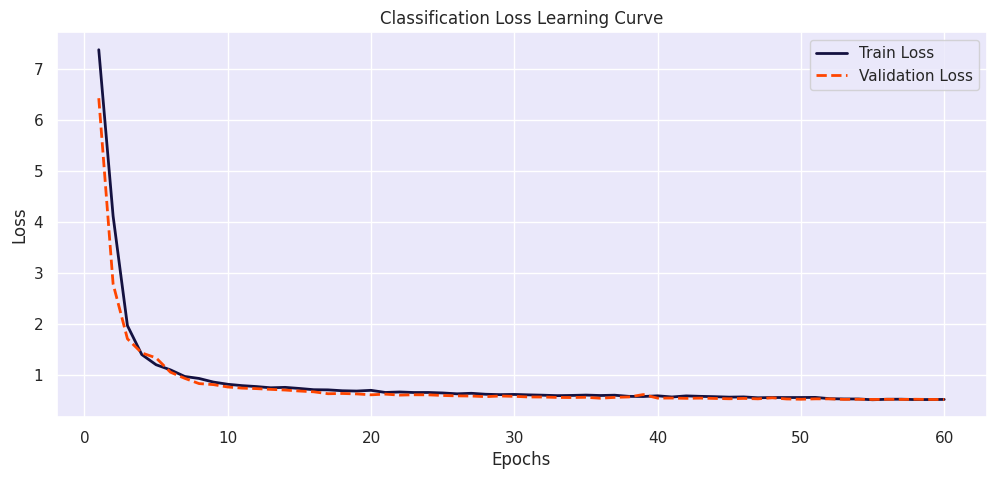

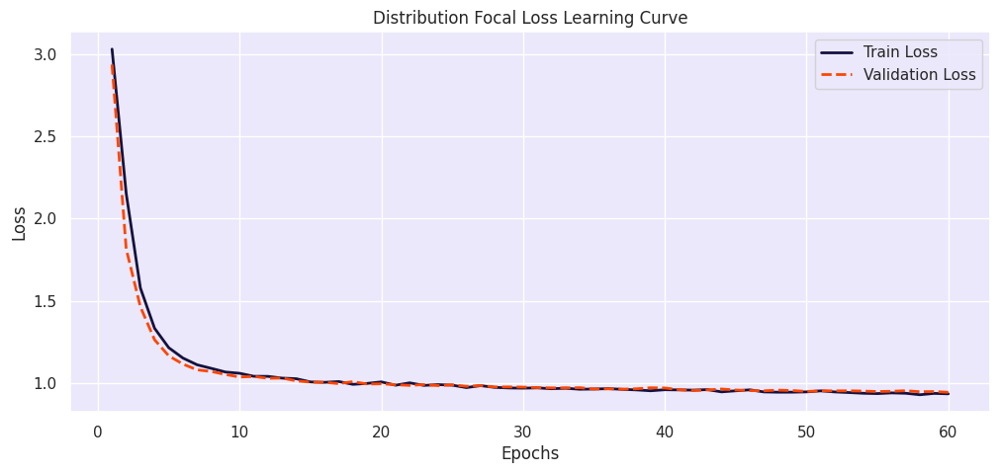

In [ ]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join('/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/runs/detect/train5/results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

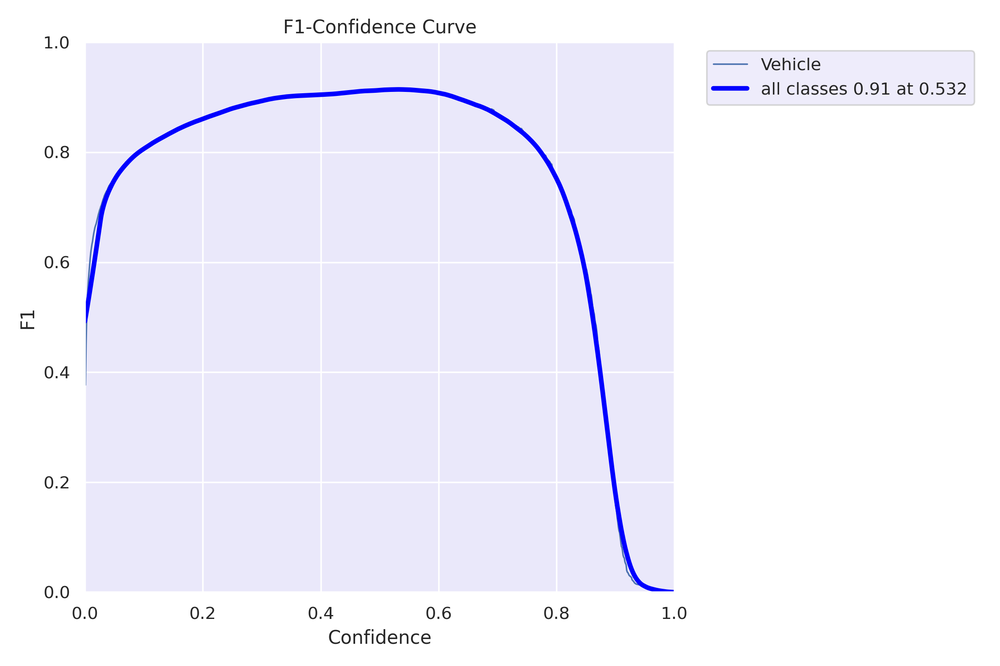

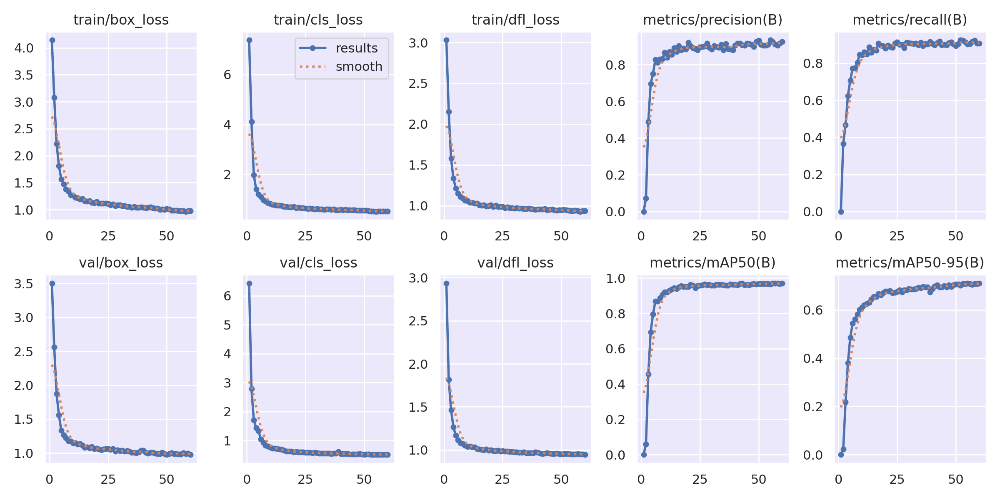

In [ ]:
# @title Display Image
from IPython.display import Image, display
display(Image(filename='/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/runs/detect/train5/F1_curve.png'))
display(Image(filename='/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/runs/detect/train5/results.png'))

In [ ]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join('/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/runs/detect/train5/weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.49 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


100%|██████████| 755k/755k [00:00<00:00, 19.7MB/s]
val: Scanning /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/valid/labels.cache... 90 images, 0 backgrounds, 0 corrupt: 100%|██████████| 90/90 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 6/6 [00:27<00:00,  4.52s/it]


                   all         90        937      0.926      0.906       0.97      0.711
               Vehicle         90        937      0.926      0.906       0.97      0.711
Speed: 1.1ms preprocess, 5.0ms inference, 0.0ms loss, 2.0ms postprocess per image
Results saved to runs/detect/val


In [ ]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.926
metrics/recall(B),0.906
metrics/mAP50(B),0.970
metrics/mAP50-95(B),0.711
fitness,0.737


#Application

In [ ]:
# Install Ultralytics library
!pip install ultralytics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 904.4/904.4 kB 57.2 MB/s eta 0:00:00


In [ ]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


In [ ]:
from ultralytics import YOLO

# Charger le modèle YOLO pré-entraîné
model = YOLO('yolov8n.pt')

# Sauvegarder le modèle localement
model_path = "best_modele.pt"
model.export(format="torchscript")  # Exporter dans le format torchscript
model.save(model_path)  # Sauvegarder sous le nom souhaité

print(f"Le modèle a été sauvegardé sous le nom : {model_path}")


100%|██████████| 6.25M/6.25M [00:00<00:00, 275MB/s]


Ultralytics 8.3.56 🚀 Python-3.10.12 torch-2.5.1+cu121 CPU (Intel Xeon 2.00GHz)
YOLOv8n summary (fused): 168 layers, 3,151,904 parameters, 0 gradients, 8.7 GFLOPs

PyTorch: starting from 'yolov8n.pt' with input shape (1, 3, 640, 640) BCHW and output shape(s) (1, 84, 8400) (6.2 MB)

TorchScript: starting export with torch 2.5.1+cu121...
TorchScript: export success ✅ 2.2s, saved as 'yolov8n.torchscript' (12.5 MB)

Export complete (4.6s)
Results saved to /content
Predict:         yolo predict task=detect model=yolov8n.torchscript imgsz=640  
Validate:        yolo val task=detect model=yolov8n.torchscript imgsz=640 data=coco.yaml  
Visualize:       https://netron.app
Le modèle a été sauvegardé sous le nom : best_modele.pt



image 1/1 /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/sample_image.jpg: 384x640 9 cars, 7.3ms
Speed: 2.0ms preprocess, 7.3ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


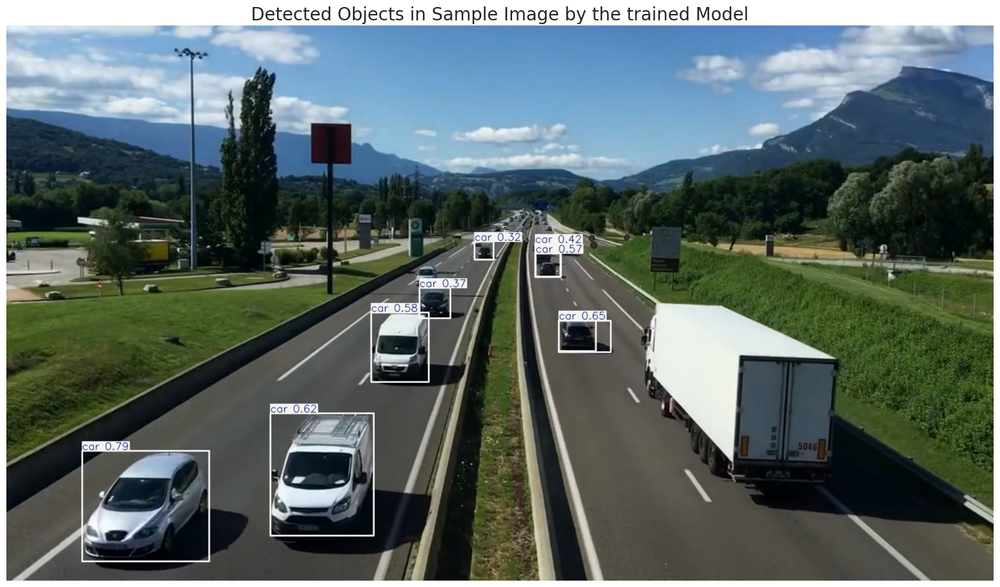

In [ ]:
# Path to the image file
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')
image_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/sample_image.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.3)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the trained Model', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /content/tet.jpg: 448x640 11 cars, 9.2ms
Speed: 1.9ms preprocess, 9.2ms inference, 2.3ms postprocess per image at shape (1, 3, 448, 640)


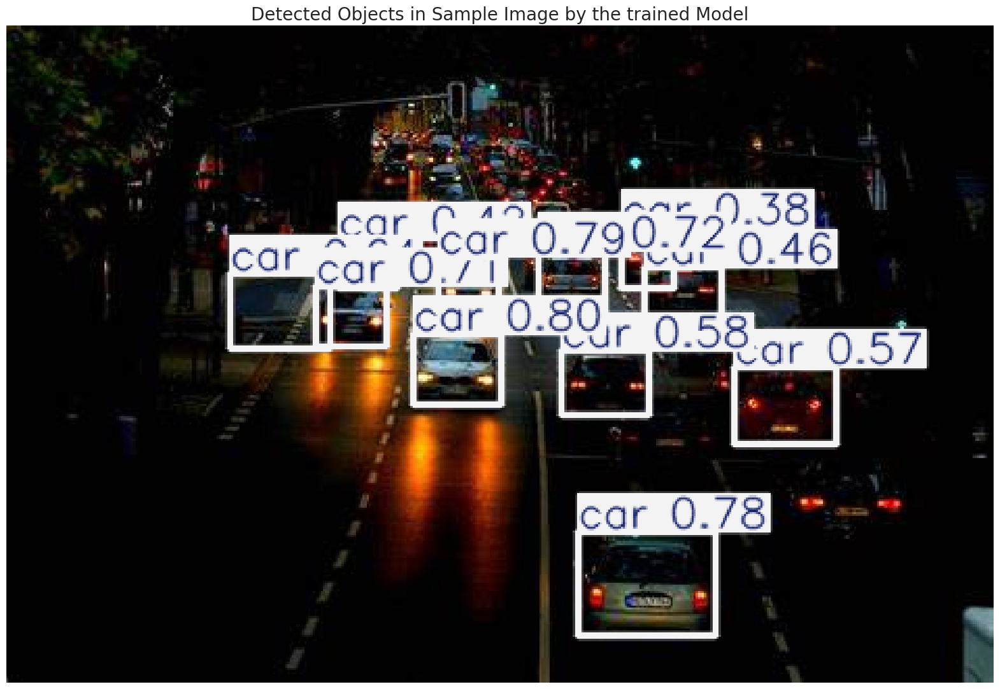

In [ ]:
# Path to the image file
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')
image_path = '/content/tet.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path,
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.3)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the trained Model', fontsize=20)
plt.axis('off')
plt.show()

In [ ]:
import cv2
from ultralytics import YOLO

# Charger le modèle YOLO pré-entraîné
model = YOLO('yolov8n.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/fourway.avi'

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Définir le chemin et les paramètres de la vidéo de sortie
output_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/output1_video.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
out = cv2.VideoWriter(output_path, fourcc, fps, (frame_width, frame_height))

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Effectuer la prédiction sur la frame actuelle
    results = model.predict(source=frame, imgsz=640, conf=0.3, verbose=False)

    # Annoter la frame avec les résultats de la détection
    annotated_frame = results[0].plot(line_width=2)

    # Écrire la frame annotée dans la vidéo de sortie
    out.write(annotated_frame)

# Libérer les ressources
cap.release()
out.release()

# Remarque : Pas besoin de cv2.destroyAllWindows() ici, car aucune fenêtre n'est créée.

print(f"La vidéo annotée a été sauvegardée à: {output_path}")


Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_0.jpg


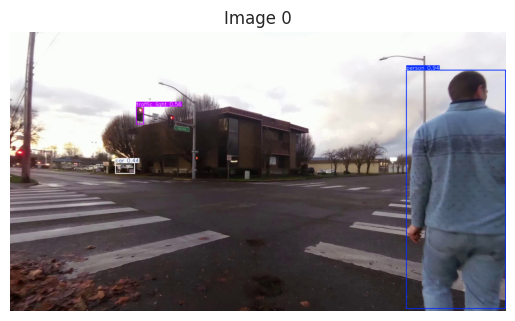

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_1.jpg


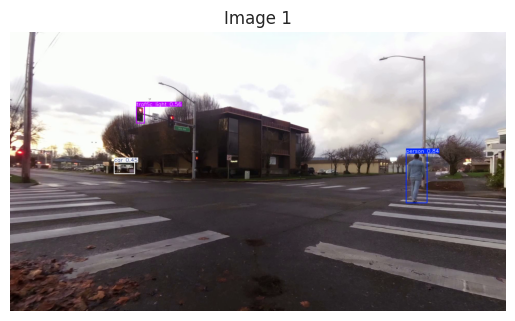

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_2.jpg


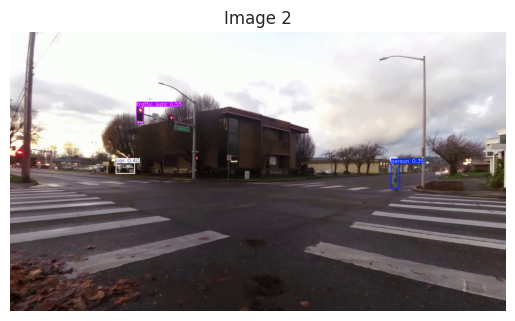

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_3.jpg


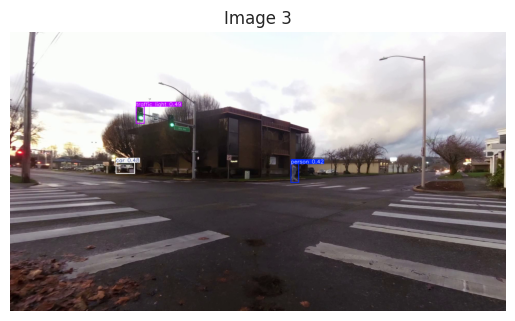

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_4.jpg


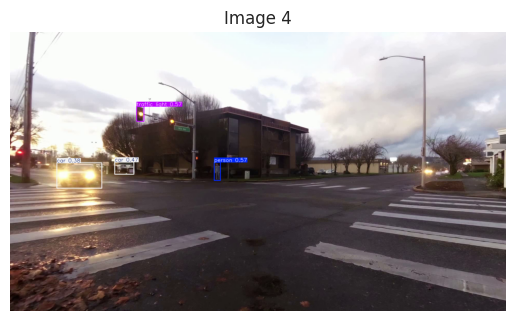

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_5.jpg


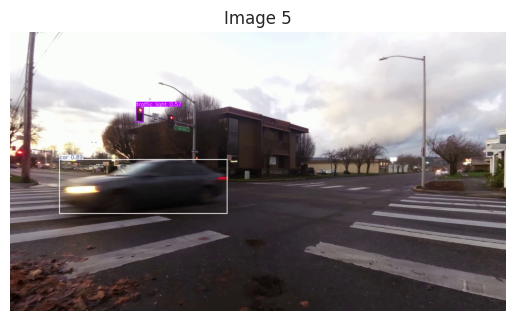

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_6.jpg


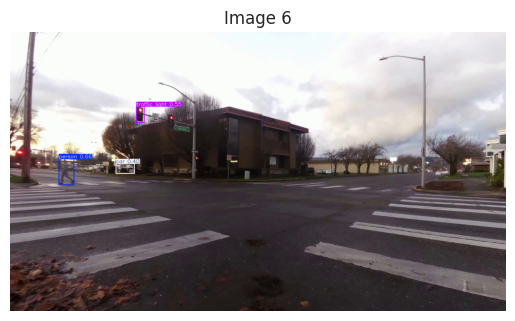

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_7.jpg


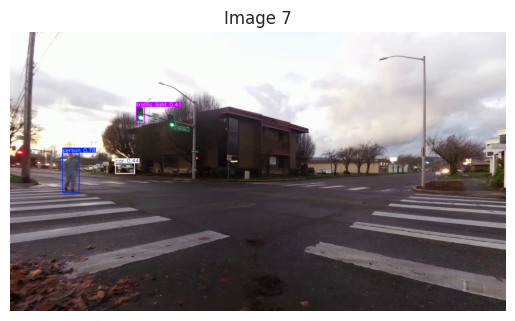

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_8.jpg


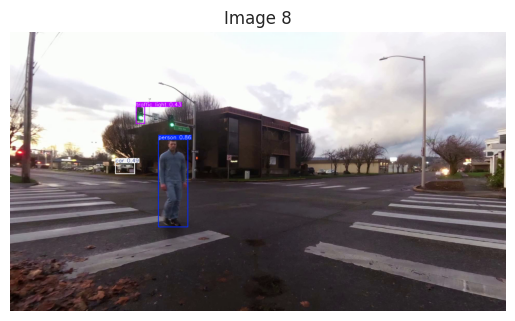

Traitement terminé. Les images annotées sont sauvegardées dans : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/


In [ ]:
import cv2
import os
from ultralytics import YOLO
from matplotlib import pyplot as plt

# Charger le modèle YOLO pré-entraîné
model = YOLO('yolov8n.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/fourway.avi'

# Dossier de sortie pour les images annotées
output_folder = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/'
os.makedirs(output_folder, exist_ok=True)

# Intervalle de temps pour capturer des images (en secondes)
time_interval = 5

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_interval = time_interval * fps  # Convertir l'intervalle de temps en frames

frame_count = 0  # Compteur de frames
image_count = 0  # Compteur d'images sauvegardées

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Vérifier si la frame actuelle correspond à l'intervalle
    if frame_count % frame_interval == 0:
        # Effectuer la prédiction sur la frame actuelle
        results = model.predict(source=frame, imgsz=640, conf=0.3, verbose=False)

        # Annoter la frame avec les résultats de la détection
        annotated_frame = results[0].plot(line_width=2)

        # Générer le chemin du fichier de sortie
        output_image_path = os.path.join(output_folder, f'annotated_image_{image_count}.jpg')

        # Sauvegarder l'image annotée
        cv2.imwrite(output_image_path, annotated_frame)
        print(f'Image sauvegardée : {output_image_path}')

        # Afficher l'image sauvegardée
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {image_count}')
        plt.axis('off')
        plt.show()

        image_count += 1

    frame_count += 1

# Libérer les ressources
cap.release()
print(f"Traitement terminé. Les images annotées sont sauvegardées dans : {output_folder}")


Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_0.jpg


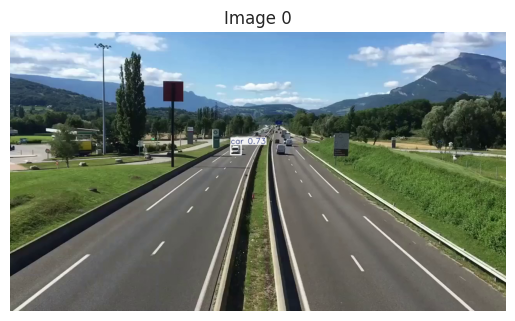

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_1.jpg


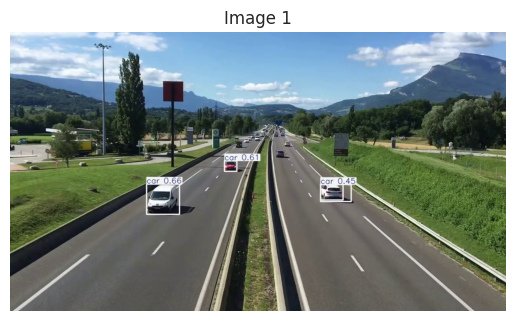

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_2.jpg


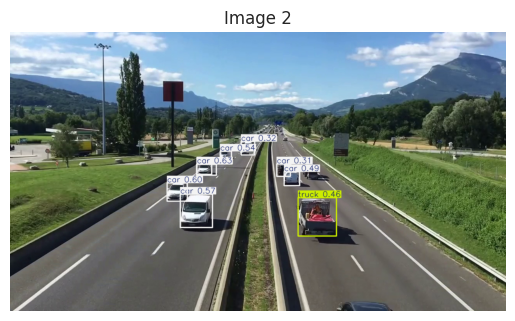

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_3.jpg


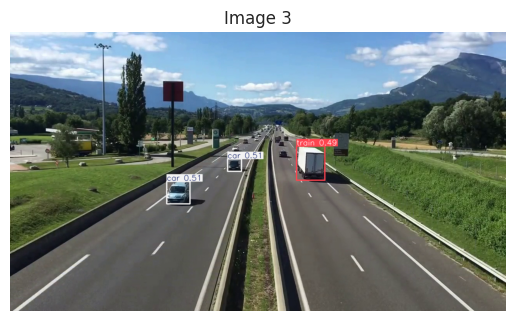

Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_4.jpg


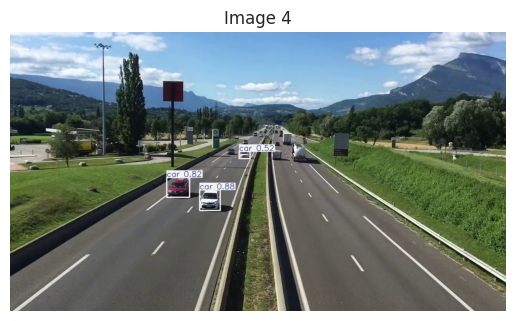

Traitement terminé. Les images annotées sont sauvegardées dans : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/


In [ ]:
import cv2
import os
from ultralytics import YOLO
from matplotlib import pyplot as plt

# Charger le modèle personnalisé YOLO
model = YOLO('/content/best_modele.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/sample_video.mp4'

# Dossier de sortie pour les images annotées
output_folder = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/'
os.makedirs(output_folder, exist_ok=True)

# Intervalle de temps pour capturer des images (en secondes)
time_interval = 5

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_interval = time_interval * fps  # Convertir l'intervalle de temps en frames

frame_count = 0  # Compteur de frames
image_count = 0  # Compteur d'images sauvegardées

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Vérifier si la frame actuelle correspond à l'intervalle
    if frame_count % frame_interval == 0:
        # Effectuer la prédiction sur la frame actuelle
        results = model.predict(source=frame, imgsz=640, conf=0.3, verbose=False)

        # Annoter la frame avec les résultats de la détection
        annotated_frame = results[0].plot(line_width=2)

        # Générer le chemin du fichier de sortie
        output_image_path = os.path.join(output_folder, f'annotated_image_{image_count}.jpg')

        # Sauvegarder l'image annotée
        cv2.imwrite(output_image_path, annotated_frame)
        print(f'Image sauvegardée : {output_image_path}')

        # Afficher l'image sauvegardée
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {image_count}')
        plt.axis('off')
        plt.show()

        image_count += 1

    frame_count += 1

# Libérer les ressources
cap.release()
print(f"Traitement terminé. Les images annotées sont sauvegardées dans : {output_folder}")



0: 384x640 3 cars, 85.2ms
Speed: 2.7ms preprocess, 85.2ms inference, 944.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_0.jpg


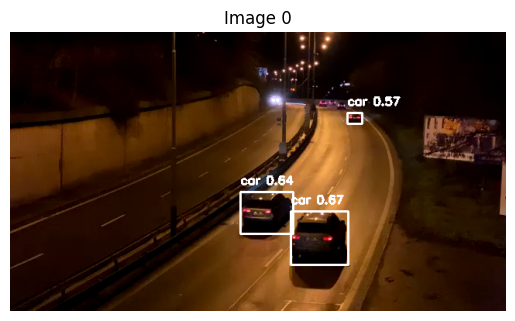


0: 384x640 6 cars, 10.6ms
Speed: 1.6ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_1.jpg


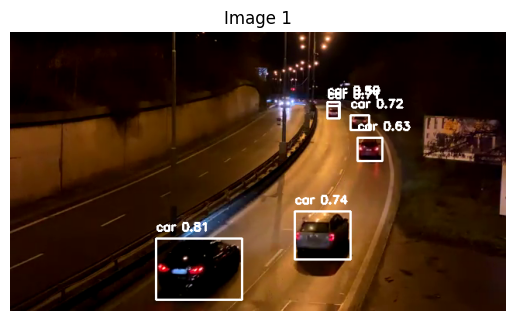


0: 384x640 1 car, 1 train, 11.0ms
Speed: 1.6ms preprocess, 11.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_2.jpg


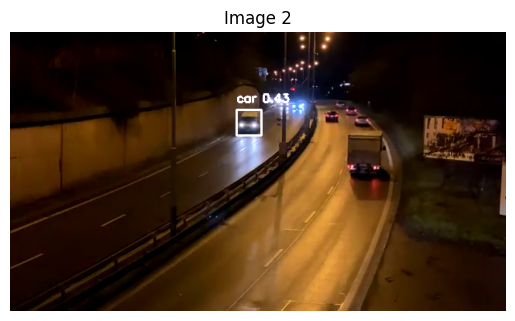


0: 384x640 2 cars, 1 train, 13.5ms
Speed: 1.6ms preprocess, 13.5ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_3.jpg


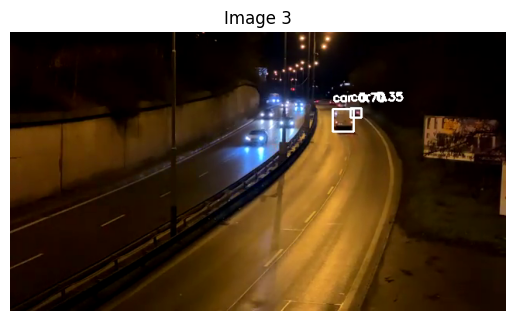


0: 384x640 1 car, 13.3ms
Speed: 1.6ms preprocess, 13.3ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_4.jpg


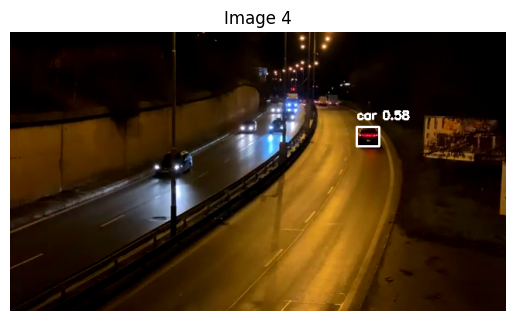


0: 384x640 1 car, 1 train, 12.5ms
Speed: 1.7ms preprocess, 12.5ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_5.jpg


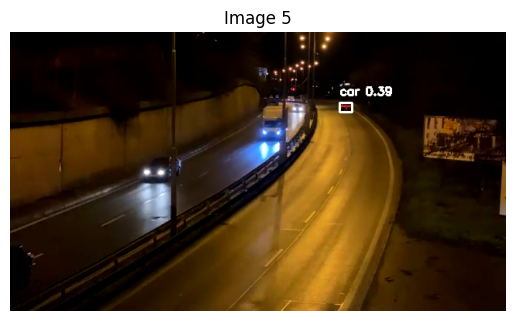


0: 384x640 2 cars, 1 train, 9.1ms
Speed: 1.6ms preprocess, 9.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_6.jpg


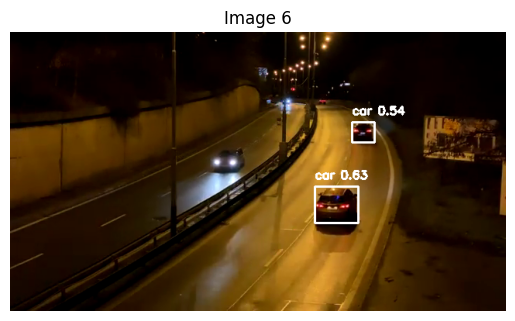


0: 384x640 2 cars, 1 train, 10.0ms
Speed: 2.5ms preprocess, 10.0ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_7.jpg


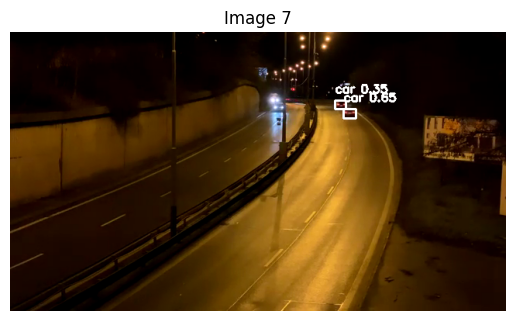


0: 384x640 1 car, 2 trains, 10.1ms
Speed: 1.6ms preprocess, 10.1ms inference, 8.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_8.jpg


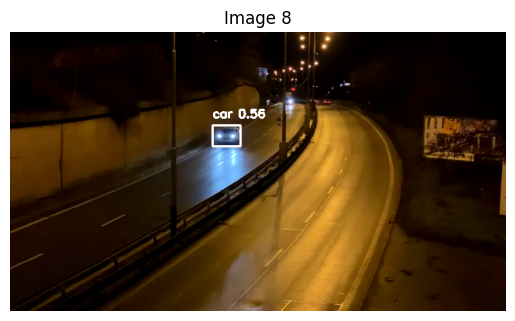


0: 384x640 1 train, 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_9.jpg


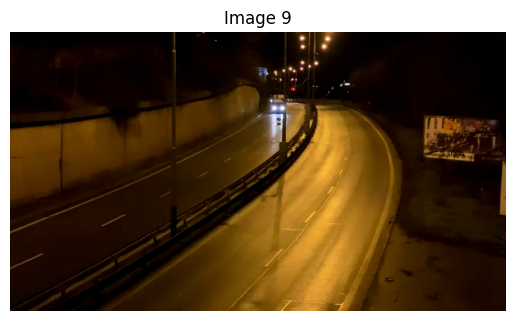


0: 384x640 1 car, 1 train, 9.5ms
Speed: 1.6ms preprocess, 9.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_10.jpg


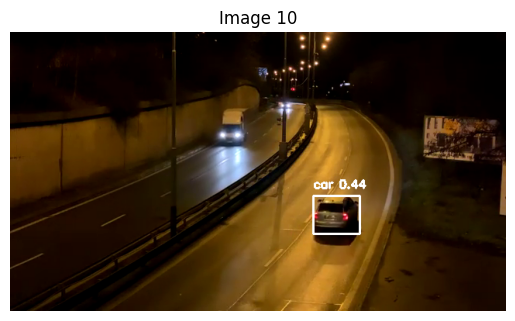


0: 384x640 4 cars, 11.3ms
Speed: 2.3ms preprocess, 11.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_11.jpg


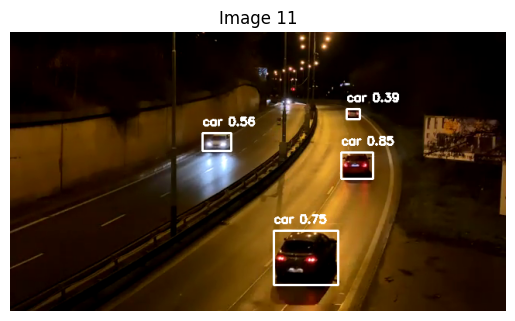


0: 384x640 3 cars, 1 train, 28.2ms
Speed: 11.6ms preprocess, 28.2ms inference, 6.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_12.jpg


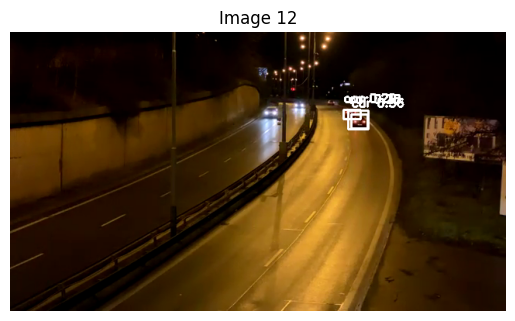


0: 384x640 5 cars, 10.6ms
Speed: 4.0ms preprocess, 10.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_13.jpg


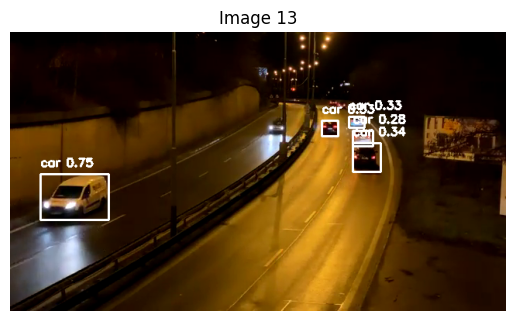


0: 384x640 3 cars, 9.4ms
Speed: 2.9ms preprocess, 9.4ms inference, 9.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_14.jpg


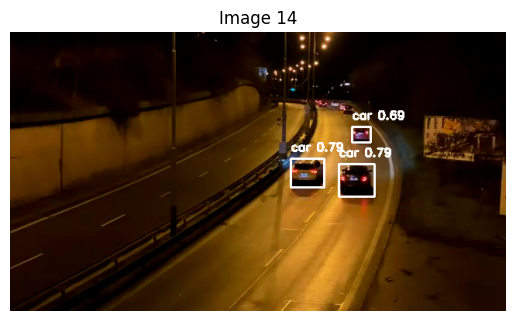


0: 384x640 2 trains, 18.4ms
Speed: 1.6ms preprocess, 18.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_15.jpg


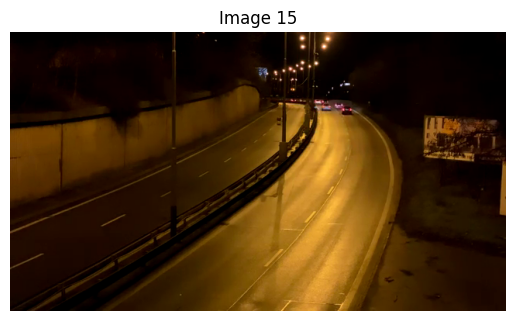


0: 384x640 1 train, 10.9ms
Speed: 2.4ms preprocess, 10.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_16.jpg


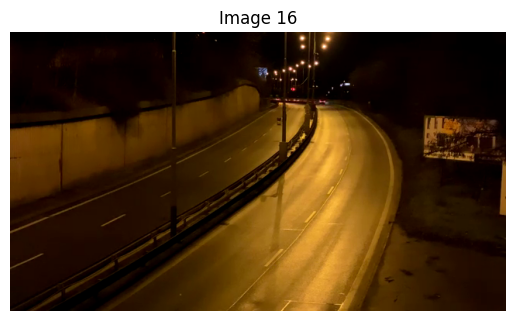


0: 384x640 1 train, 50.0ms
Speed: 1.7ms preprocess, 50.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_17.jpg


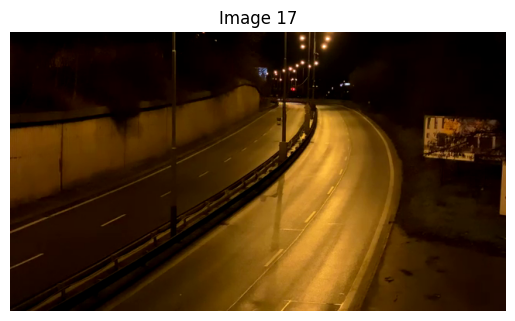


0: 384x640 1 train, 14.6ms
Speed: 1.7ms preprocess, 14.6ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_18.jpg


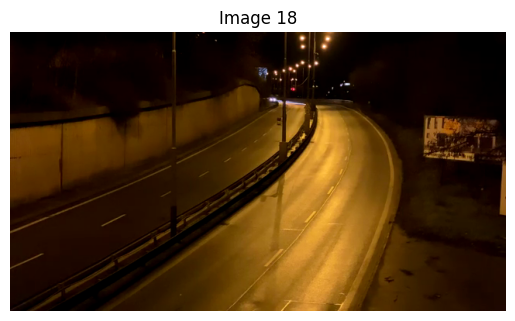


0: 384x640 1 train, 31.5ms
Speed: 2.0ms preprocess, 31.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_19.jpg


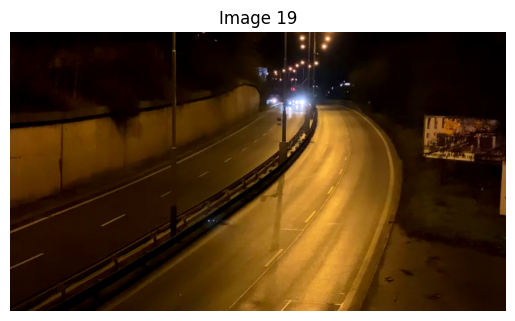


0: 384x640 1 train, 58.6ms
Speed: 1.6ms preprocess, 58.6ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_20.jpg


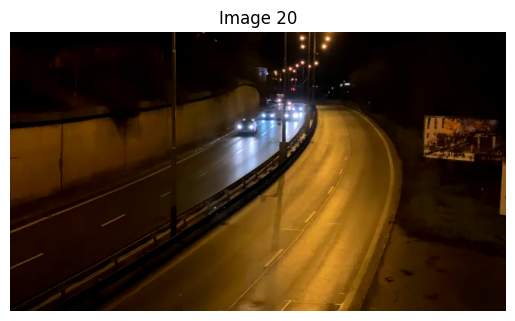


0: 384x640 3 cars, 1 train, 11.6ms
Speed: 1.5ms preprocess, 11.6ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_21.jpg


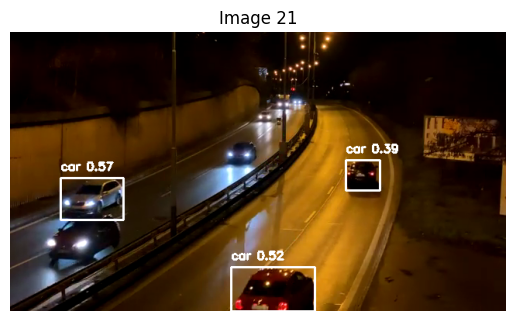


0: 384x640 4 cars, 33.0ms
Speed: 1.6ms preprocess, 33.0ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_22.jpg


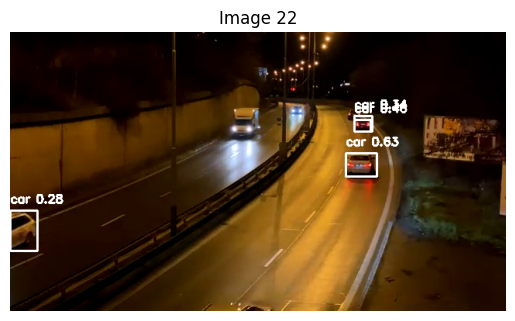


0: 384x640 2 cars, 1 train, 15.4ms
Speed: 1.8ms preprocess, 15.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_23.jpg


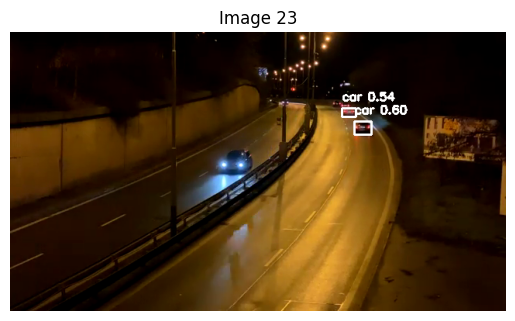


0: 384x640 1 train, 19.5ms
Speed: 1.7ms preprocess, 19.5ms inference, 10.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_24.jpg


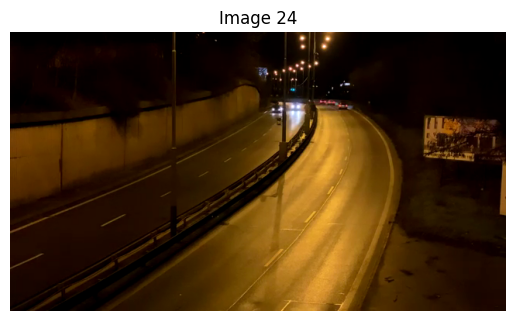


0: 384x640 (no detections), 13.8ms
Speed: 1.6ms preprocess, 13.8ms inference, 0.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_25.jpg


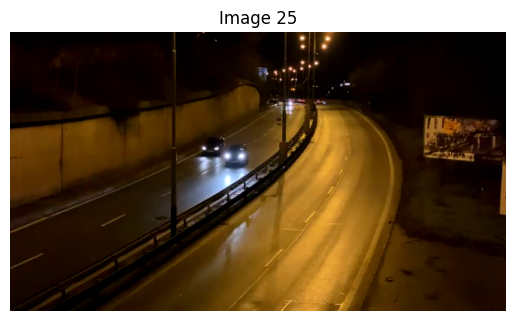


0: 384x640 1 car, 1 train, 33.8ms
Speed: 1.8ms preprocess, 33.8ms inference, 15.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_26.jpg


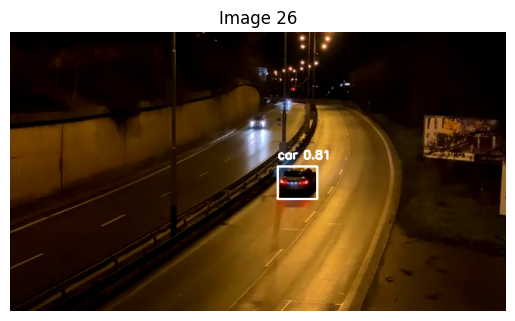


0: 384x640 2 cars, 2 trains, 38.2ms
Speed: 2.3ms preprocess, 38.2ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_27.jpg


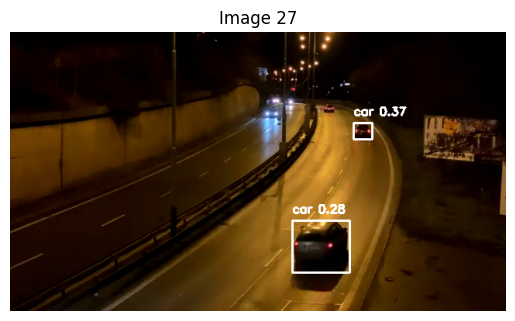


0: 384x640 1 car, 1 train, 22.7ms
Speed: 1.7ms preprocess, 22.7ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_28.jpg


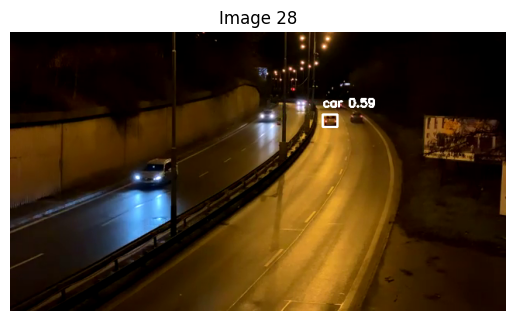


0: 384x640 1 train, 65.1ms
Speed: 8.2ms preprocess, 65.1ms inference, 24.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_29.jpg


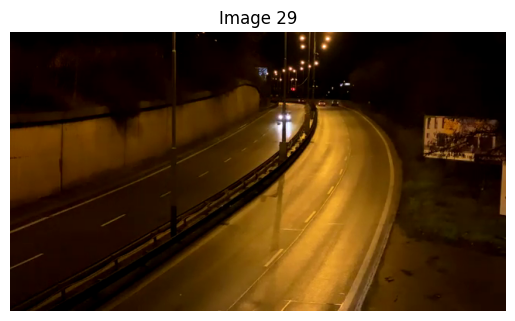


0: 384x640 1 car, 1 train, 12.3ms
Speed: 1.8ms preprocess, 12.3ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_30.jpg


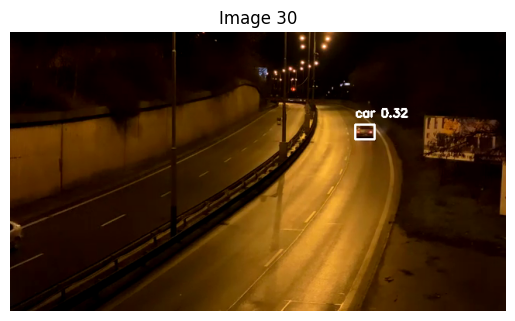


0: 384x640 1 train, 30.4ms
Speed: 10.4ms preprocess, 30.4ms inference, 9.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_31.jpg


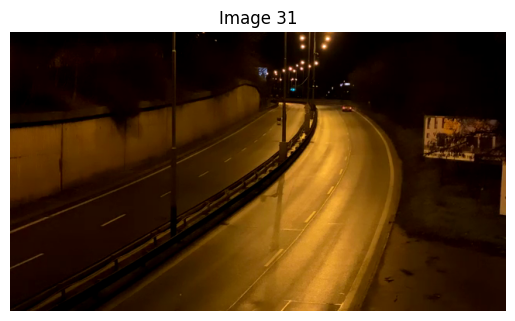


0: 384x640 1 car, 2 trains, 12.6ms
Speed: 1.6ms preprocess, 12.6ms inference, 2.4ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_32.jpg


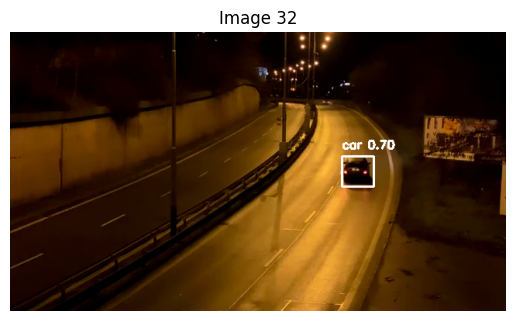


0: 384x640 1 train, 41.0ms
Speed: 6.1ms preprocess, 41.0ms inference, 10.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_33.jpg


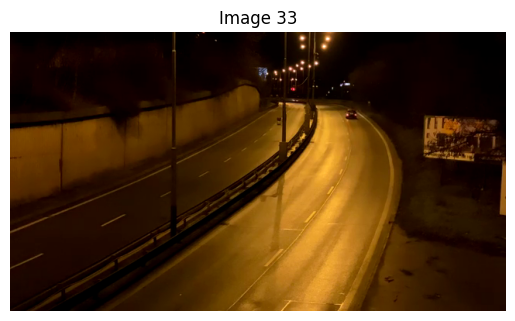


0: 384x640 1 train, 46.6ms
Speed: 1.8ms preprocess, 46.6ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_34.jpg


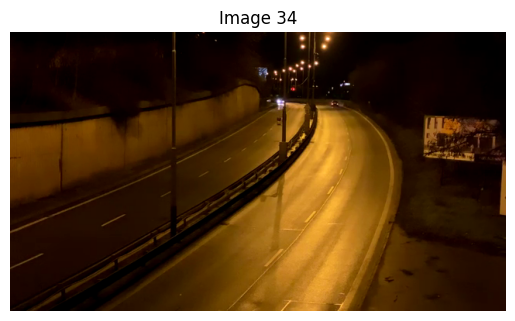


0: 384x640 1 car, 1 train, 12.1ms
Speed: 2.1ms preprocess, 12.1ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_35.jpg


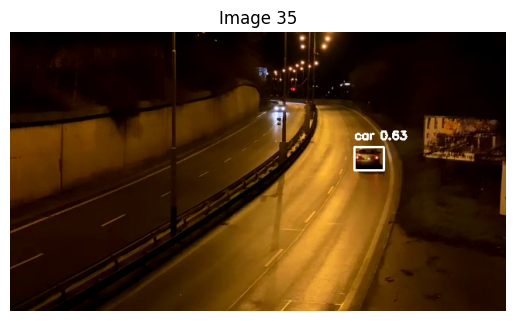


0: 384x640 1 car, 1 train, 17.8ms
Speed: 1.9ms preprocess, 17.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_36.jpg


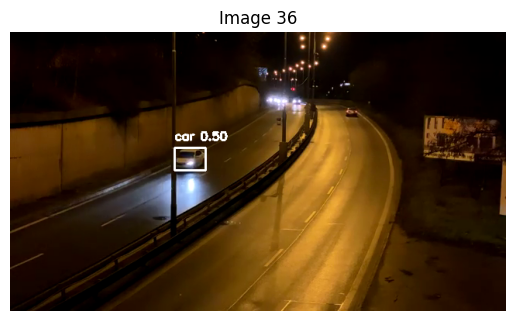


0: 384x640 1 car, 1 train, 16.4ms
Speed: 2.5ms preprocess, 16.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_37.jpg


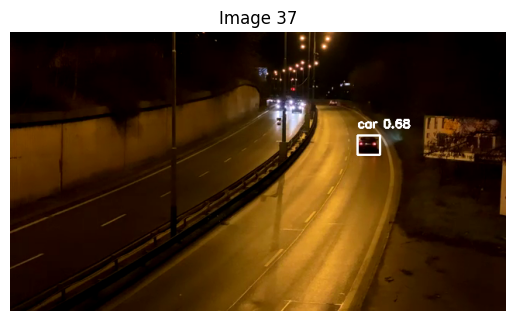


0: 384x640 2 cars, 18.4ms
Speed: 1.6ms preprocess, 18.4ms inference, 6.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_38.jpg


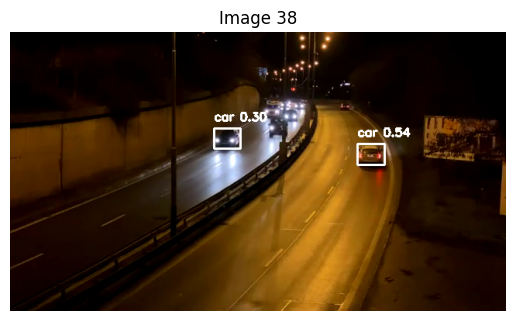


0: 384x640 1 train, 23.5ms
Speed: 1.5ms preprocess, 23.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_39.jpg


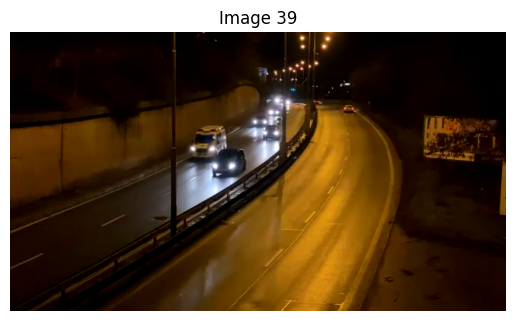


0: 384x640 1 train, 19.7ms
Speed: 1.7ms preprocess, 19.7ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_40.jpg


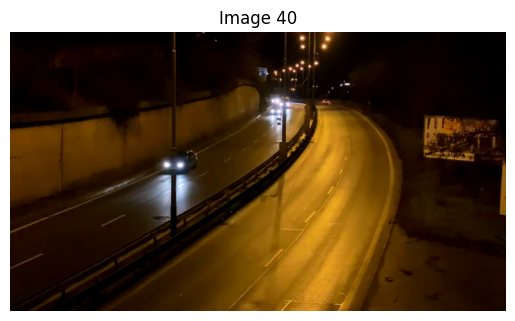


0: 384x640 2 cars, 14.0ms
Speed: 1.6ms preprocess, 14.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_41.jpg


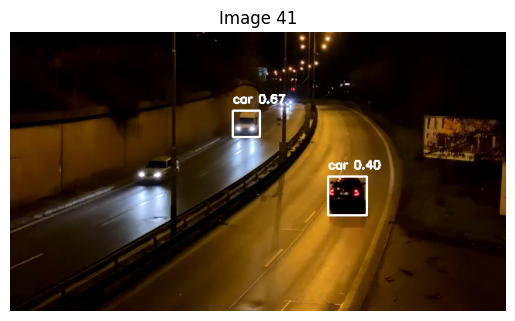


0: 384x640 1 car, 1 train, 19.0ms
Speed: 1.6ms preprocess, 19.0ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_42.jpg


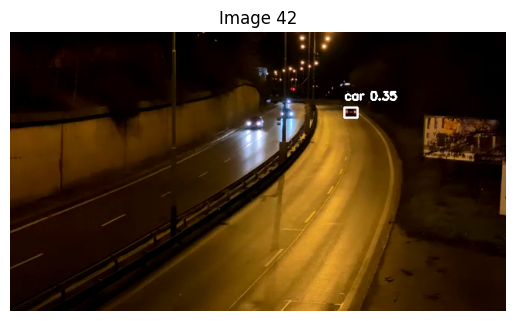


0: 384x640 2 cars, 1 train, 21.2ms
Speed: 1.6ms preprocess, 21.2ms inference, 8.4ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_43.jpg


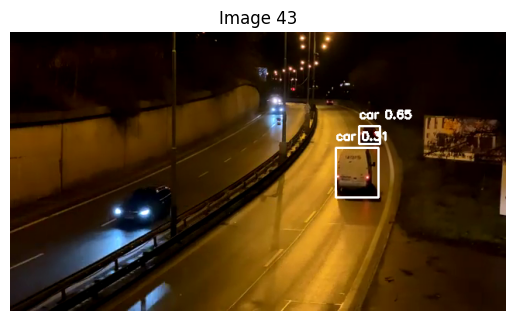


0: 384x640 3 cars, 11.9ms
Speed: 2.7ms preprocess, 11.9ms inference, 2.3ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_44.jpg


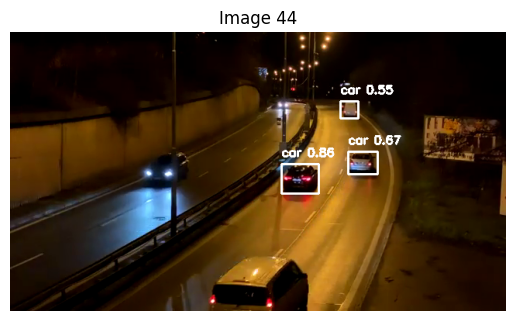


0: 384x640 4 cars, 10.5ms
Speed: 2.6ms preprocess, 10.5ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_45.jpg


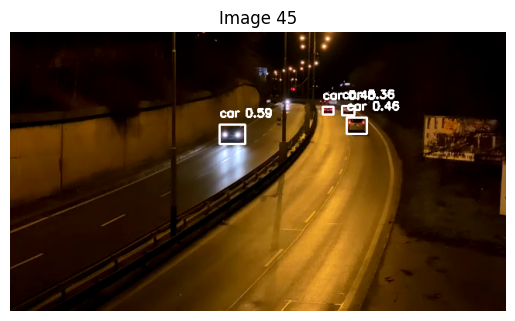

Traitement terminé. Les images annotées sont sauvegardées dans : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/


In [ ]:
import cv2
import os
from ultralytics import YOLO
from matplotlib import pyplot as plt

# Charger le modèle personnalisé YOLO
model = YOLO('/content/best_modele.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/videoplayback.mp4'

# Dossier de sortie pour les images annotées
output_folder = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/'
os.makedirs(output_folder, exist_ok=True)

# Intervalle de temps pour capturer des images (en secondes)
time_interval = 5

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_interval = time_interval * fps  # Convertir l'intervalle de temps en frames

frame_count = 0  # Compteur de frames
image_count = 0  # Compteur d'images sauvegardées

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Vérifier si la frame actuelle correspond à l'intervalle
    if frame_count % frame_interval == 0:
        # Effectuer la prédiction sur la frame actuelle
        results = model(frame)

        # Récupérer les boîtes et classes
        boxes = results[0].boxes.xyxy  # Coordonnées des boîtes (x1, y1, x2, y2)
        confs = results[0].boxes.conf  # Scores de confiance
        classes = results[0].boxes.cls  # Classes des objets détectés

        # Filtrer les résultats pour exclure les trains
        filtered_boxes = []
        filtered_confs = []
        filtered_classes = []

        for i in range(len(classes)):
            if model.names[int(classes[i])] != "train":  # Exclure les trains
                filtered_boxes.append(boxes[i])
                filtered_confs.append(confs[i])
                filtered_classes.append(classes[i])

        # Annoter la frame avec les résultats filtrés
        annotated_frame = frame.copy()
        for i in range(len(filtered_boxes)):
            x1, y1, x2, y2 = map(int, filtered_boxes[i])  # Coordonnées de la boîte
            cls = int(filtered_classes[i])  # Classe
            conf = float(filtered_confs[i])  # Confiance
            label = f"{model.names[cls]} {conf:.2f}"
            cv2.rectangle(annotated_frame, (x1, y1), (x2, y2), (255, 255, 255), 2)
            cv2.putText(annotated_frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

        # Générer le chemin du fichier de sortie
        output_image_path = os.path.join(output_folder, f'annotated_image_{image_count}.jpg')

        # Sauvegarder l'image annotée
        cv2.imwrite(output_image_path, annotated_frame)
        print(f'Image sauvegardée : {output_image_path}')

        # Afficher l'image sauvegardée
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {image_count}')
        plt.axis('off')
        plt.show()

        image_count += 1

    frame_count += 1

# Libérer les ressources
cap.release()
print(f"Traitement terminé. Les images annotées sont sauvegardées dans : {output_folder}")



0: 384x640 3 cars, 13.0ms
Speed: 1.5ms preprocess, 13.0ms inference, 3.4ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_0.jpg


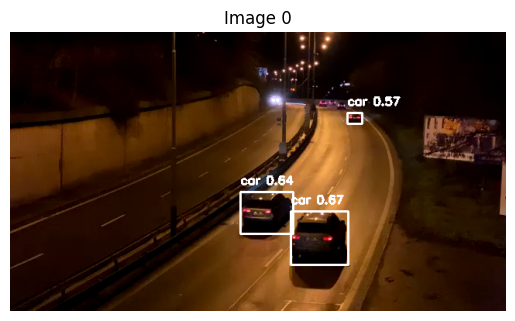


0: 384x640 6 cars, 21.4ms
Speed: 1.6ms preprocess, 21.4ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_1.jpg


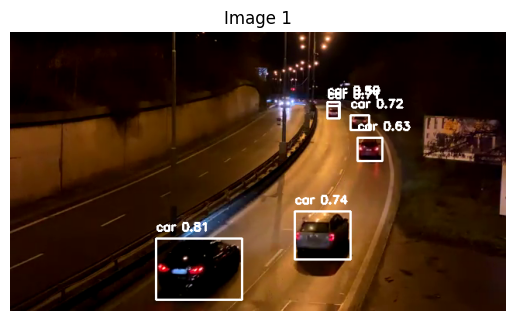


0: 384x640 1 car, 1 train, 11.9ms
Speed: 1.6ms preprocess, 11.9ms inference, 1.8ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_2.jpg


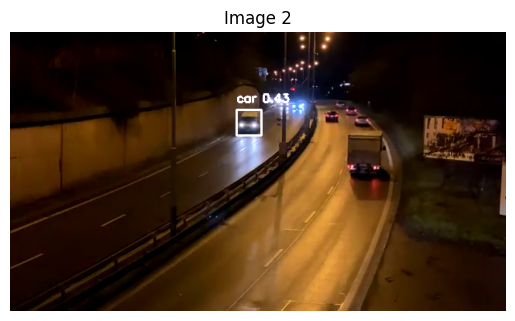


0: 384x640 2 cars, 1 train, 10.6ms
Speed: 1.8ms preprocess, 10.6ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_3.jpg


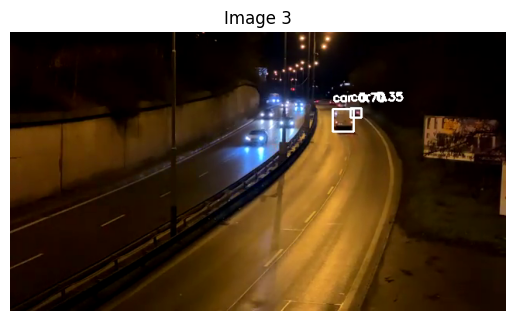


0: 384x640 1 car, 10.3ms
Speed: 1.7ms preprocess, 10.3ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_4.jpg


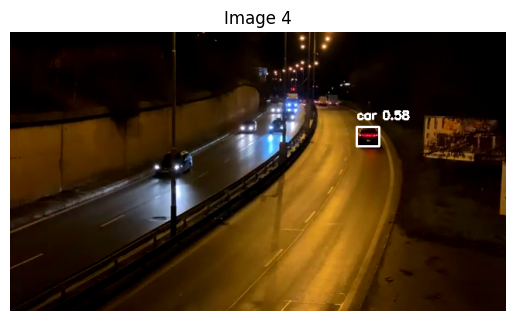


0: 384x640 1 car, 1 train, 12.7ms
Speed: 1.6ms preprocess, 12.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_5.jpg


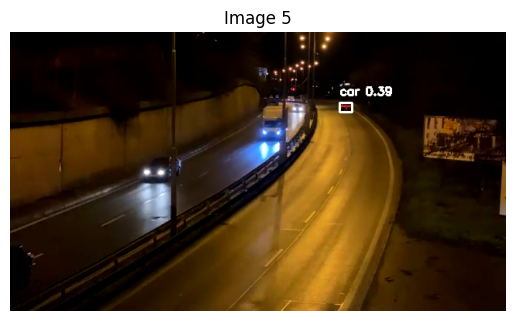


0: 384x640 2 cars, 1 train, 9.6ms
Speed: 2.9ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_6.jpg


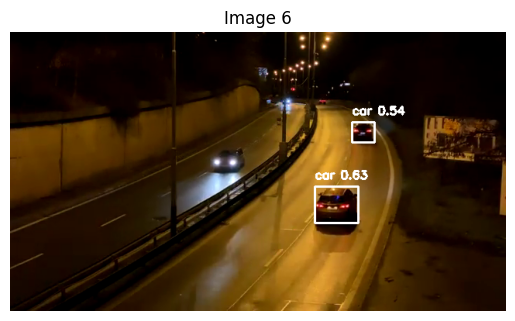


0: 384x640 2 cars, 1 train, 10.5ms
Speed: 1.9ms preprocess, 10.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_7.jpg


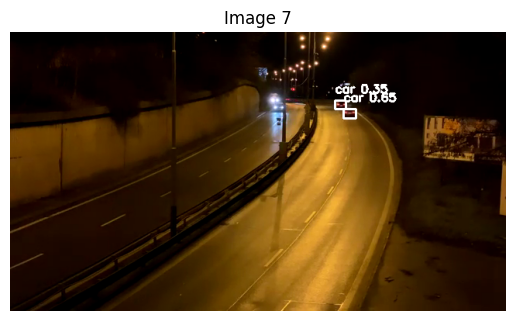


0: 384x640 1 car, 2 trains, 11.6ms
Speed: 1.5ms preprocess, 11.6ms inference, 2.1ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_8.jpg


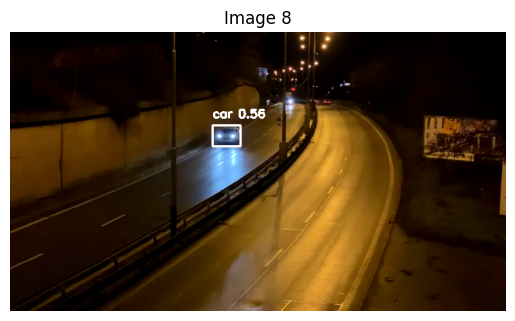


0: 384x640 1 train, 9.5ms
Speed: 1.9ms preprocess, 9.5ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_9.jpg


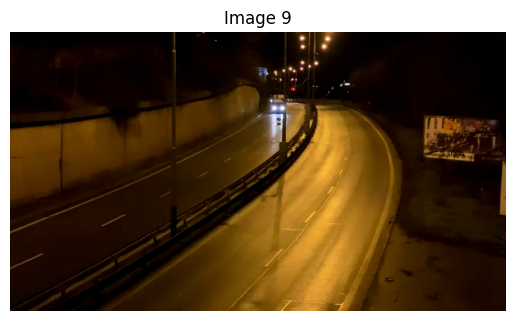


0: 384x640 1 car, 1 train, 10.4ms
Speed: 1.6ms preprocess, 10.4ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_10.jpg


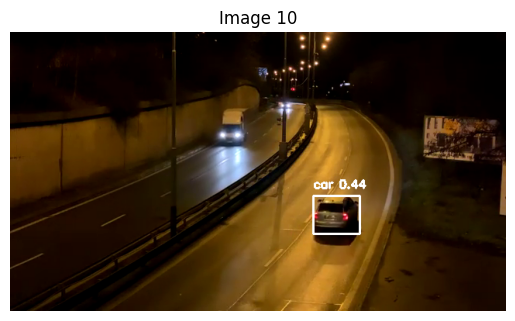


0: 384x640 4 cars, 11.0ms
Speed: 1.5ms preprocess, 11.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_11.jpg


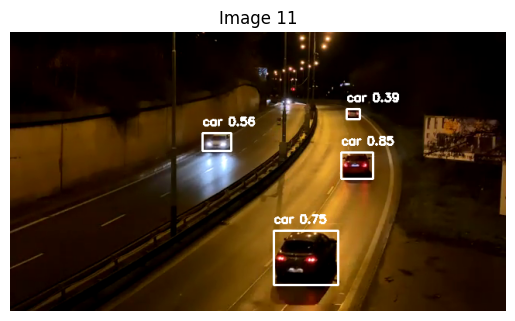


0: 384x640 3 cars, 1 train, 10.4ms
Speed: 1.9ms preprocess, 10.4ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_12.jpg


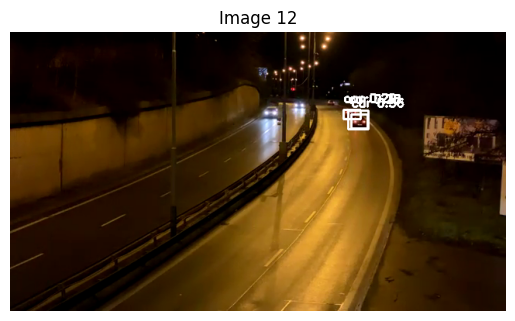


0: 384x640 5 cars, 11.1ms
Speed: 2.0ms preprocess, 11.1ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_13.jpg


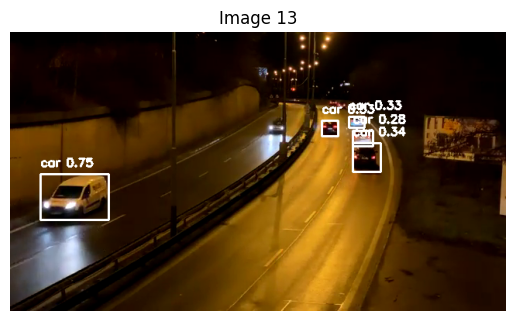


0: 384x640 3 cars, 10.5ms
Speed: 1.9ms preprocess, 10.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_14.jpg


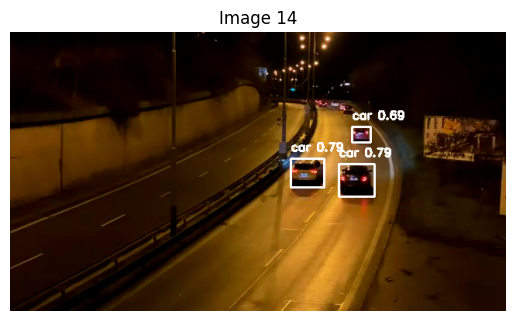


0: 384x640 2 trains, 10.5ms
Speed: 1.9ms preprocess, 10.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_15.jpg


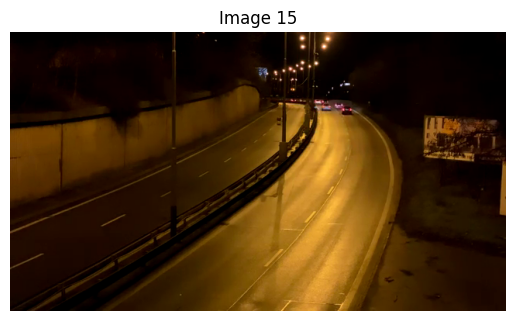


0: 384x640 1 train, 9.6ms
Speed: 1.7ms preprocess, 9.6ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_16.jpg


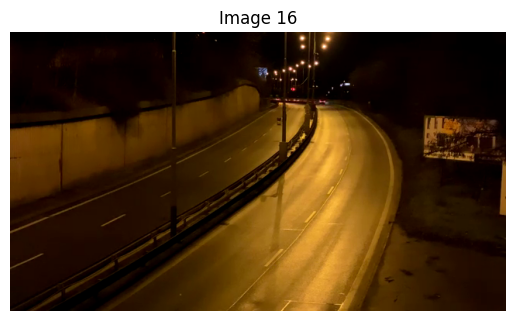


0: 384x640 1 train, 10.5ms
Speed: 1.9ms preprocess, 10.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_17.jpg


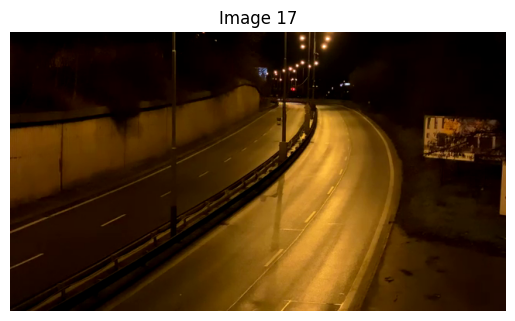


0: 384x640 1 train, 17.1ms
Speed: 1.6ms preprocess, 17.1ms inference, 2.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_18.jpg


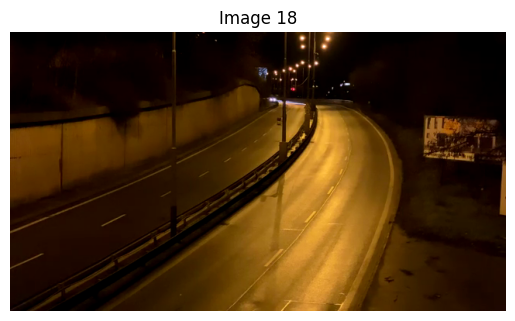


0: 384x640 1 train, 9.8ms
Speed: 1.9ms preprocess, 9.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_19.jpg


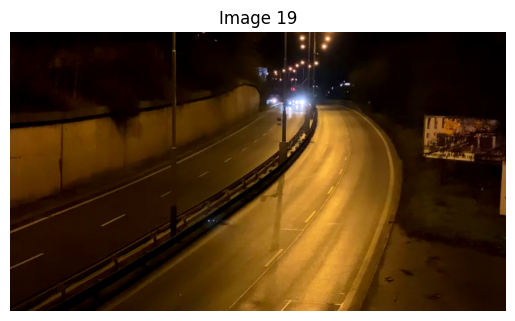


0: 384x640 1 train, 10.5ms
Speed: 1.6ms preprocess, 10.5ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_20.jpg


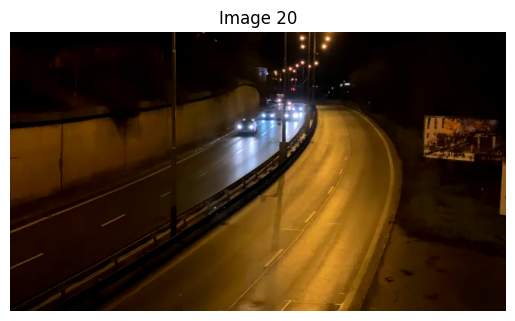


0: 384x640 3 cars, 1 train, 9.7ms
Speed: 1.9ms preprocess, 9.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_21.jpg


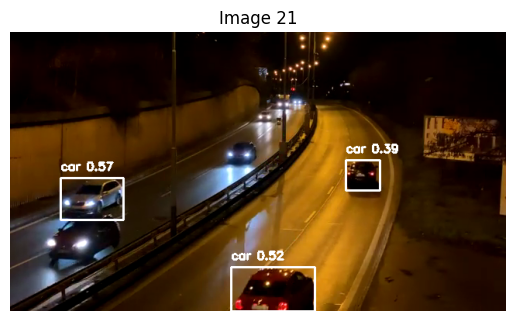


0: 384x640 4 cars, 9.8ms
Speed: 1.6ms preprocess, 9.8ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_22.jpg


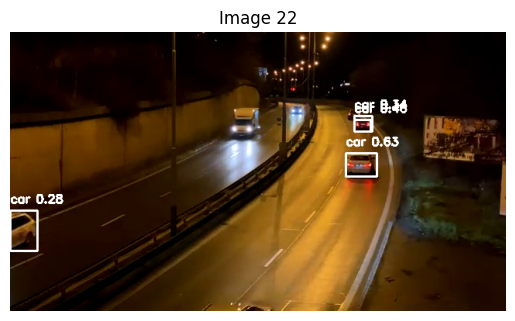


0: 384x640 2 cars, 1 train, 10.3ms
Speed: 1.8ms preprocess, 10.3ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_23.jpg


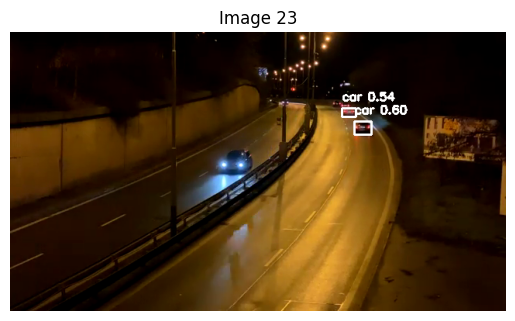


0: 384x640 1 train, 9.9ms
Speed: 1.6ms preprocess, 9.9ms inference, 1.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_24.jpg


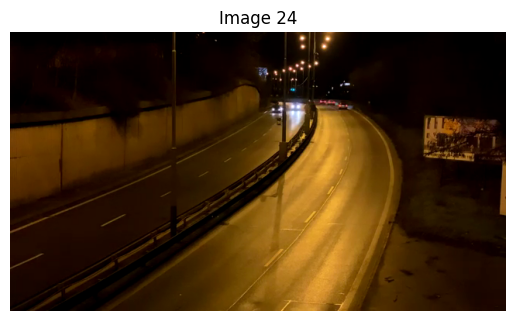


0: 384x640 (no detections), 10.9ms
Speed: 1.8ms preprocess, 10.9ms inference, 0.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_25.jpg


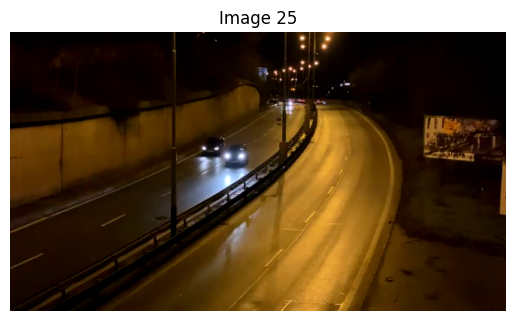


0: 384x640 1 car, 1 train, 55.2ms
Speed: 26.1ms preprocess, 55.2ms inference, 8.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_26.jpg


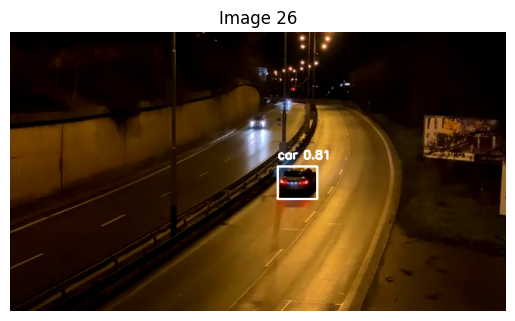


0: 384x640 2 cars, 2 trains, 73.2ms
Speed: 1.6ms preprocess, 73.2ms inference, 9.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_27.jpg


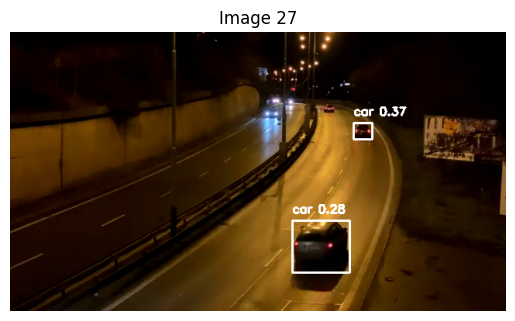


0: 384x640 1 car, 1 train, 12.5ms
Speed: 1.7ms preprocess, 12.5ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_28.jpg


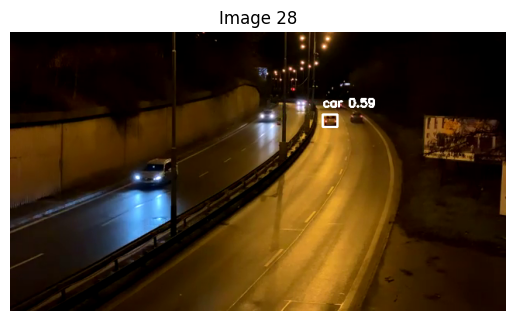


0: 384x640 1 train, 14.1ms
Speed: 1.6ms preprocess, 14.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_29.jpg


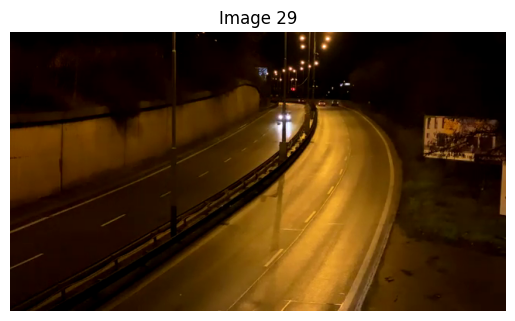


0: 384x640 1 car, 1 train, 11.0ms
Speed: 1.6ms preprocess, 11.0ms inference, 2.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_30.jpg


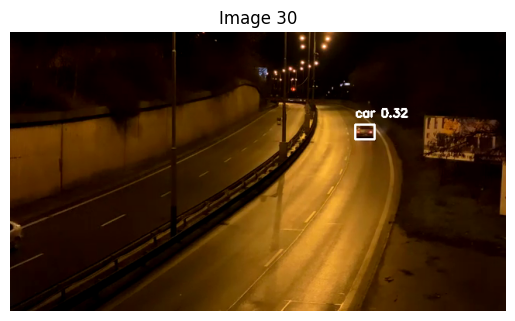


0: 384x640 1 train, 21.0ms
Speed: 2.5ms preprocess, 21.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_31.jpg


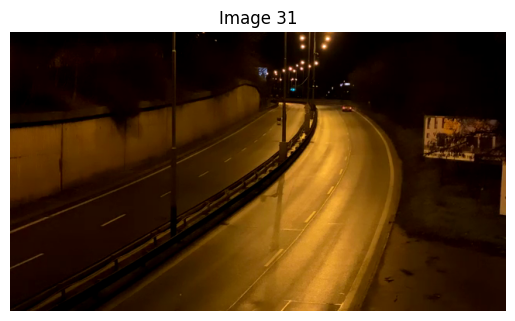


0: 384x640 1 car, 2 trains, 9.7ms
Speed: 1.6ms preprocess, 9.7ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_32.jpg


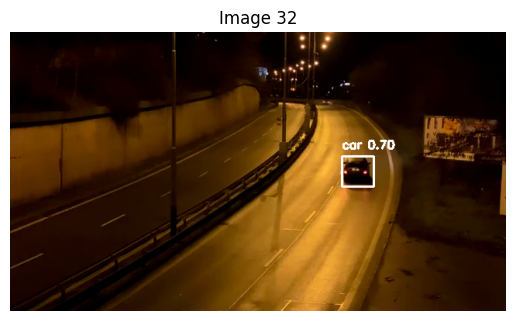


0: 384x640 1 train, 15.5ms
Speed: 1.6ms preprocess, 15.5ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_33.jpg


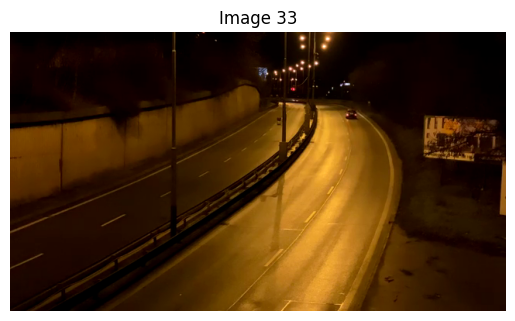


0: 384x640 1 train, 11.1ms
Speed: 1.7ms preprocess, 11.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_34.jpg


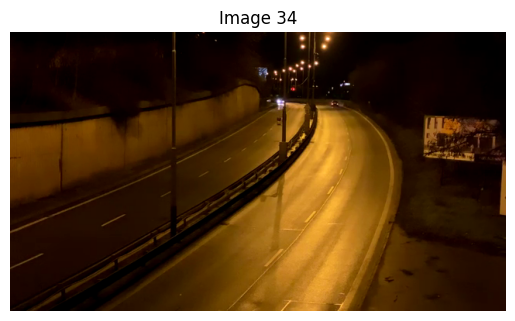


0: 384x640 1 car, 1 train, 24.0ms
Speed: 1.5ms preprocess, 24.0ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_35.jpg


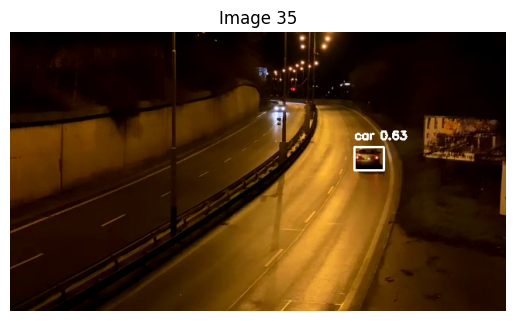


0: 384x640 1 car, 1 train, 13.9ms
Speed: 1.6ms preprocess, 13.9ms inference, 4.5ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_36.jpg


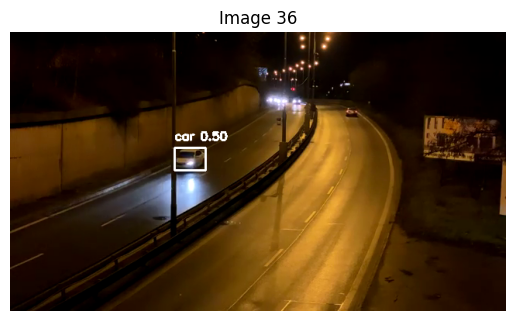


0: 384x640 1 car, 1 train, 20.7ms
Speed: 1.6ms preprocess, 20.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_37.jpg


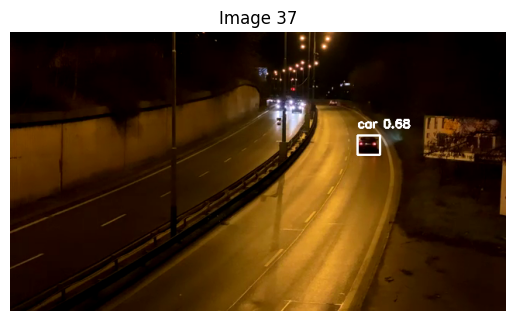


0: 384x640 2 cars, 11.9ms
Speed: 1.6ms preprocess, 11.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_38.jpg


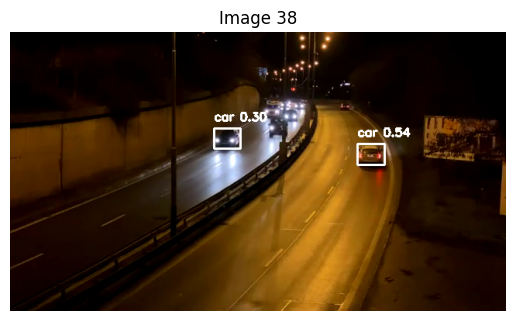


0: 384x640 1 train, 9.9ms
Speed: 1.5ms preprocess, 9.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_39.jpg


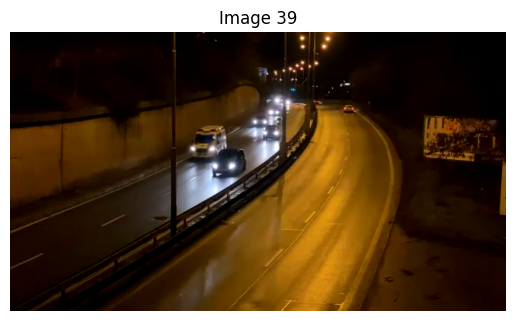


0: 384x640 1 train, 11.8ms
Speed: 1.6ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_40.jpg


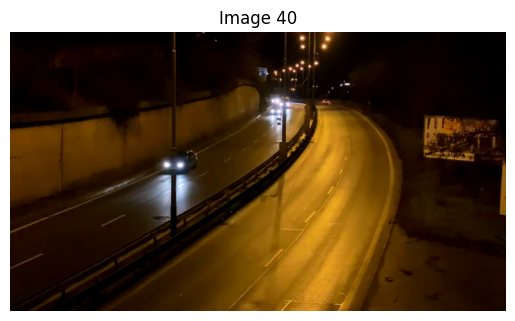


0: 384x640 2 cars, 9.9ms
Speed: 2.3ms preprocess, 9.9ms inference, 2.0ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_41.jpg


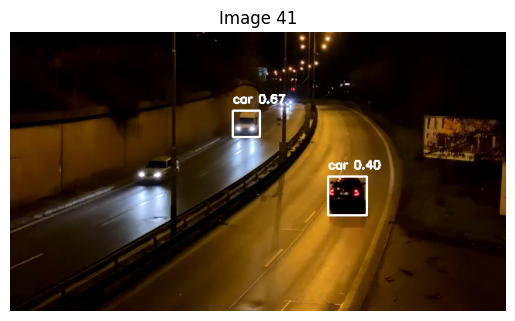


0: 384x640 1 car, 1 train, 12.1ms
Speed: 2.0ms preprocess, 12.1ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_42.jpg


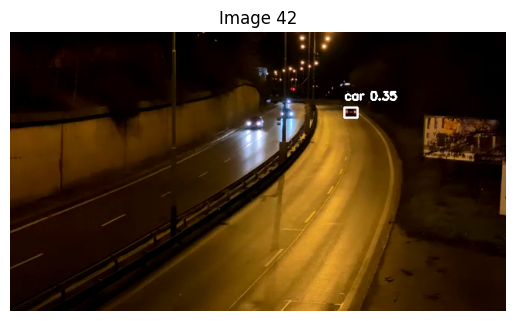


0: 384x640 2 cars, 1 train, 11.0ms
Speed: 1.6ms preprocess, 11.0ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_43.jpg


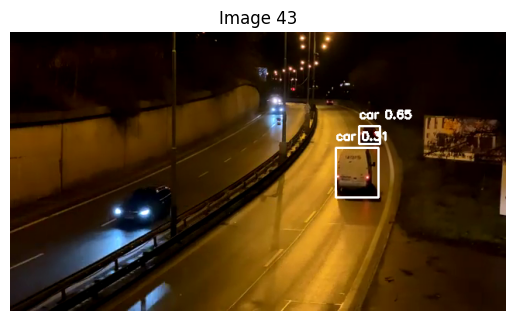


0: 384x640 3 cars, 10.7ms
Speed: 3.2ms preprocess, 10.7ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_44.jpg


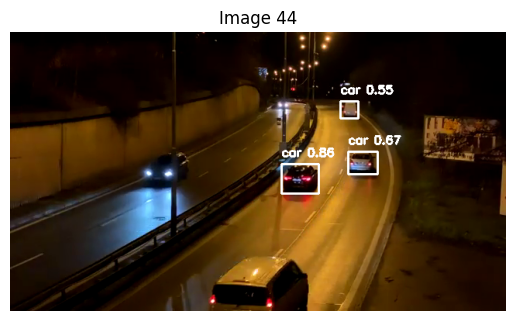


0: 384x640 4 cars, 8.9ms
Speed: 1.6ms preprocess, 8.9ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)
Image sauvegardée : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/annotated_image_45.jpg


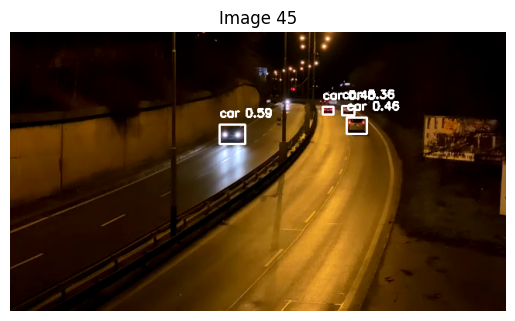

Traitement terminé. Les images annotées sont sauvegardées dans : /content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/


In [ ]:
import cv2
import os
from ultralytics import YOLO
from matplotlib import pyplot as plt

# Charger le modèle personnalisé YOLO
model = YOLO('/content/best_modele.pt')

# Chemin vers la vidéo d'entrée
video_path = '/content/videoplayback.mp4'

# Dossier de sortie pour les images annotées
output_folder = '/content/drive/MyDrive/inno data/Vehicle_Detection_Image_Dataset/annotated_images/'
os.makedirs(output_folder, exist_ok=True)

# Intervalle de temps pour capturer des images (en secondes)
time_interval = 5

# Ouvrir la vidéo d'entrée
cap = cv2.VideoCapture(video_path)

# Obtenir des propriétés de la vidéo d'entrée
fps = int(cap.get(cv2.CAP_PROP_FPS))
frame_interval = time_interval * fps  # Convertir l'intervalle de temps en frames

frame_count = 0  # Compteur de frames
image_count = 0  # Compteur d'images sauvegardées

# Lire et traiter chaque frame de la vidéo
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Vérifier si la frame actuelle correspond à l'intervalle
    if frame_count % frame_interval == 0:
        # Effectuer la prédiction sur la frame actuelle
        results = model(frame)

        # Récupérer les boîtes et classes
        boxes = results[0].boxes.xyxy  # Coordonnées des boîtes (x1, y1, x2, y2)
        confs = results[0].boxes.conf  # Scores de confiance
        classes = results[0].boxes.cls  # Classes des objets détectés

        # Filtrer les résultats pour exclure les trains
        filtered_boxes = []
        filtered_confs = []
        filtered_classes = []

        for i in range(len(classes)):
            if model.names[int(classes[i])] != "train":  # Exclure les trains
                filtered_boxes.append(boxes[i])
                filtered_confs.append(confs[i])
                filtered_classes.append(classes[i])

        # Annoter la frame avec les résultats filtrés
        annotated_frame = frame.copy()
        for i in range(len(filtered_boxes)):
            x1, y1, x2, y2 = map(int, filtered_boxes[i])  # Coordonnées de la boîte
            cls = int(filtered_classes[i])  # Classe
            conf = float(filtered_confs[i])  # Confiance
            label = f"{model.names[cls]} {conf:.2f}"
            cv2.rectangle(annotated_frame, (x1, y1), (x2, y2), (255, 255, 255), 2)
            cv2.putText(annotated_frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2)

        # Générer le chemin du fichier de sortie
        output_image_path = os.path.join(output_folder, f'annotated_image_{image_count}.jpg')

        # Sauvegarder l'image annotée
        cv2.imwrite(output_image_path, annotated_frame)
        print(f'Image sauvegardée : {output_image_path}')

        # Afficher l'image sauvegardée
        plt.imshow(cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB))
        plt.title(f'Image {image_count}')
        plt.axis('off')
        plt.show()

        image_count += 1

    frame_count += 1

# Libérer les ressources
cap.release()
print(f"Traitement terminé. Les images annotées sont sauvegardées dans : {output_folder}")
